# Abstract

There are currently no free services to help Airbnb hosts decide how to price their listing. Airbnb itself suggests the choice is “completely up to you” (Airbnb, 2020) and recommends searching for similar listings in the neighbourhood. Given the public availability of web-scraped data from Airbnb of many properties and their listings, the following report investigates what features seem to be most useful in predicting price per night. The analysis will look at more than 80 features, and will then use the 36 most relevant ones to compare and contrast 3 different very popular models - Decision Tree, Boosted Trees (XGBoost) and Random Forests. The best model is within a factor of 1.45 from the actual prices with 70% R2 and shows that price setting is a highly competitive exercise with the price of nearby properties along with the type of property a host is offering are the most important features. 

# Table of Contents

<a class="anchor" id="chapter1"></a>
1. [Introduction](#introduction)
2. [Exploratory Data Analysis](#eda)
 * [Venues](#venues)
 * [Amenities](#amenities)
 * [Map](#map)
 * [Reviews](#reviews)
 * [Correlation Matrix](#cm)
3. [Model Variables](#mv)
4. [Decision Tree](#dt)
 * [Feature Importance](#fi1)
5. [XGBoost](#xgb)
 * [Hyperparameter Tuning](#ht1)
 * [Feature Importance](#fi2)
6. [Random Forests](#rf)
 * [Hyperparameter Tuning](#ht2)
 * [Feature Importance](#fi3)
 * [Permutation Importance](#pi)
7. [Conclusion](#conclusion)
8. [References](#ref)

# Introduction <a class="anchor" id="introduction"></a>

Airbnb is a home-sharing platform started in 2008 allowing home owners to list their properties on a website and guests being able to view and book them. As of today, the platform has more than 6 million listings in 191 countries, "*which is more than the top 5 hotel chains combined*" (Airbnb, 2020) Business Insider suggests that in 2017, the USA was the biggest market with 660,000 listings (Business Insider, 2017). Since its launch, AirBnB has hosted 400 million guests, and on an average night in 2018 around 2 million people stay in one of their properties. (Much Needed, 2020) The same source suggests that Tokyo, Paris and New York City are the most popular destinations and cites Morgan Stanley research from 2017 that 49% of platform’s users use it as an alternative to a hotel.

In this analysis, I will use a dataset of Airbnb listings in New York, provided by insideairbnb.com. The website stores publicly available information listings that people can use. The dataset contains a wide range of features (>100) for more than 50,000 NYC listings. The goal of the analysis is to use a range of statistical techniques to try and predict the booking price of a property with accuracy. An important limitation of the approach is that the only publicly available price data is the asking price rather than transaction prices. As Coles et al. (2017) suggest, asking prices overestimate Airbnb prices, so should be taken with a grain of salt. I will complement this dataset with information about a wide range of venues in New York sourced from Google Places.

* **listings** - Descriptive information on tens of thousands of Airbnb listings along the U.S. East Coast. Source: insideairbnb.com

* **venues** -Important details about hundreds of thousands of venues in the metropolitan areas included in listings. Source: Google Places

# Exploratory Data Analysis<a class="anchor" id="eda"></a>

Before taking a look at the data, it is useful to get a bit of context about Airbnb dynamics in New York. Analysis of internal Airbnb data between 2011 and 2016 by Coles et al. (2017) suggests that in that period listings have spread much further, in that the percentage of booked listings inside Manhattan fell from 66% to 54% and the average distance to the Empire State Building increased from 4.8 to 6 km. Interestingly, their analysis shows that compared to the long-term market, short-term prices decline much slower the further one is from the Empire State Building, suggesting that Airbnb users may not mind the commute that much. The authors show that “private room” listings have grown faster than “entire home” listings. Comparing the two listings types, the former are much more concentrated in lower income neighbourhoods. To wrap up this background analysis, the researchers calculated that about 10% of entire home listings on Airbnb are booked more than 180 nights per year.

The original dataset has many columns that have been dropped as they don’t seem that relevant in determining price - e.g. many URL addresses, information about host name and address, licence data etc. Other features like weekly price, square feet were removed as they mostly have missing values.


In [1]:
import pandas as pd
import numpy as np
import json
import math
import plotly.express as px
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neighbors import RadiusNeighborsClassifier
from sklearn.neighbors import DistanceMetric
from sklearn.tree import DecisionTreeRegressor,plot_tree
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn import metrics
import xgboost as xgb
from scipy import stats
import geopandas as gpd

# import requests

In [2]:
folder = "/Users/dimitribenchev/Desktop/IMPERIAL/BA Report/data-airbnb/"

In [3]:
# Raw unmodified file, as downloaded from InsideAir
# listings = pd.read_csv(folder + "listings_Jan19.csv")

# Modified file that already includes time-consuming neighbour based calculations
listings = pd.read_csv("listings_neighbours")

venues = pd.read_csv(folder + "venues.csv")

In [135]:
# listings.to_csv("listings_neighbours", index = False)
listings.filter(regex='url').columns

Index(['listing_url', 'thumbnail_url', 'medium_url', 'picture_url',
       'xl_picture_url', 'host_url', 'host_thumbnail_url', 'host_picture_url'],
      dtype='object')

In [166]:
# Drop some unnecessary columns because of majority missing values or 
# seemingly irrelevant
listings.drop(columns = ['listing_url', 'thumbnail_url', 'medium_url', 'picture_url',
                         'xl_picture_url', 'host_url', 'host_thumbnail_url', 
                         'host_picture_url', 'host_id','host_name','host_location','host_about',
                         'host_neighbourhood','host_verifications','street',
                         'city','weekly_price','monthly_price',
                         'square_feet','calendar_updated',
                         'first_review','last_review',
                        'scrape_id', 'last_scraped','experiences_offered','notes',
                        'host_has_profile_pic','host_acceptance_rate','state','market',
                        'smart_location','country_code', 'country','is_location_exact',
                        'calendar_last_scraped','requires_license','license',
                        'jurisdiction_names','is_business_travel_ready','require_guest_profile_picture'], inplace = True)


## Pre-processing

In [168]:
listings.shape

(50717, 66)

In [169]:
# Extract only year
listings['host_since'] = listings['host_since'].astype('str').str.slice(stop=4)

In [170]:
# Fill NaN values with median for the others
listings.loc[listings['host_since'].isna(),'host_since'] = listings.loc[~listings['host_since'].isna(),'host_since'].astype(np.float16).median()

In [171]:
listings['host_since'] = listings['host_since'].astype(np.float16)

In [163]:
# show number of missing values
listings.loc[:,'zipcode':].isnull().sum()
# listings.isnull().sum()

zipcode                                           678
latitude                                            0
longitude                                           0
property_type                                       0
room_type                                           0
accommodates                                        0
bathrooms                                          70
bedrooms                                           42
beds                                               42
bed_type                                            0
amenities                                           0
price                                               0
security_deposit                                18589
cleaning_fee                                    11434
guests_included                                     0
extra_people                                        0
minimum_nights                                      0
maximum_nights                                      0
minimum_minimum_nights      

In [175]:
# Drop properties with > 5 beds to show a more representative selection of properties
listings.drop(listings[listings['bedrooms'] > 5].index, inplace = True)
# remove alphabet names
# listings = listings[~listings['id'].str.contains('a|e|o|i|u|y', na = False) ]
listings['longitude'] = pd.to_numeric(listings['longitude'])
listings.drop(listings[listings['latitude'].isna()].index, inplace=True)

listings.drop(listings[listings['price'].isna()].index, inplace=True)

In [176]:
# Some Zipcodes are inconsistent
listings.loc[listings['zipcode'].str.contains('\n|-',na=False), 'zipcode']  = listings.loc[listings['zipcode'].str.contains('\n|-', na = False), 'zipcode'].str[:5] 

In [187]:
# Identify properties with missing ZIP
missing_zip = listings[(listings['zipcode'].isna()) | (listings['zipcode']==" " )|
                      (listings['zipcode'].str.contains('--',na=False))].index

In [10]:
def haversine(loc1, loc2):
    ''' used for more accurate calculation of distance between [lon,lat] coordinates'''
    lon1, lat1 = loc1
    lon2, lat2 = loc2
    R = 6371e3 # convert final distance to metres
    phi1 = lat1 * math.pi / 180 # convert to radians
    phi2 = lat2 * math.pi / 180
    delta_phi = (lat2 - lat1) * math.pi/180
    delta_lambda = (lon2 - lon1) * math.pi / 180
    a = math.sin(delta_phi / 2)**2 + math.cos(phi1) * math.cos(phi2) * math.sin(delta_lambda /2)**2
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1-a))
    d = R * c
    # this is the calculation for the "haversine"
#     d_1 = 2 * math.asin(math.sqrt(math.sin(0.5 * (loc2[0]-loc1[0])) * math.sin(0.5 * (loc2[0]-loc1[0])) +
#                                   math.cos(loc1[0]) * math.cos(loc2[0]) * math.sin(0.5 * (loc2[1]-loc1[1])) * math.sin(0.5 * (loc2[1]-loc1[1]))))
#     d_1 = 2 * math.asin(math.sqrt(math.sin(0.5 * delta_lambda) * math.sin(0.5 * delta_lambda) +
#                                   math.cos(loc1[0] * math.pi / 180) * math.cos(loc2[0] * math.pi/180) * math.sin(0.5 * delta_phi) * math.sin(0.5 * delta_phi)))
    return(d)

To determine the zip code for the listings with missing zip code the the longitude and latitude of the were used to calculate the Haversine distance. This is a more accurate representation of distance for a sphere. The 4 nearest neighbours were found, and the most frequent zip code was used. I would like to see if using zip code as a numerical variable will help us find some nonlinear patterns with regards to price.

In [190]:
# Nearest Neighbour for Zipcode
X = listings.loc[~listings.index.isin(missing_zip), ('longitude','latitude')]
y = listings.loc[~listings.index.isin(missing_zip), 'zipcode'].astype('float64')
zip_neigh = KNeighborsClassifier(n_neighbors = 4, metric = haversine)
zip_neigh.fit(X,y)

KNeighborsClassifier(algorithm='auto', leaf_size=30,
                     metric=<function haversine at 0x7f9c1bf7a7b8>,
                     metric_params=None, n_jobs=None, n_neighbors=4, p=2,
                     weights='uniform')

In [191]:
# Update NaN Zip Code based on Nearest Neighbour
listings.loc[missing_zip,'zipcode'] = listings.loc[missing_zip,['longitude', 'latitude']].apply(lambda row: zip_neigh.predict(row.to_numpy().reshape(1,-1))[0], 
                                                                                       axis=1)

In [192]:
# Update "" and " " Zip Code based on Nearest Neighbour
listings.loc[listings['zipcode']== '','zipcode'] = listings.loc[listings['zipcode']== '',['longitude', 'latitude']].apply(lambda row: zip_neigh.predict(row.to_numpy().reshape(1,-1))[0], axis=1)
listings.loc[listings['zipcode']== ' ','zipcode'] = listings.loc[listings['zipcode']== '',['longitude', 'latitude']].apply(lambda row: zip_neigh.predict(row.to_numpy().reshape(1,-1))[0], axis=1)

* **longitude** needs to be converted to numeric value
* **reviews_per_month** - there are 10,220 values missing. We could use number_of_reviews_ltm or number_of_reviews and interpolate if we see a clear relationship. However, we can see that both these values are 0, suggesting our best guess is 0.
* **review_scores** have about 10,000 missing values. It makes sense to set these to 0 as we don't have any useful insight how to infer these.
* **bathrooms** - the missing values will be set to 1.
* **host_since, host_is_superhost, host_identity_verified** are simultaneously missing for the same 465 properties. We will remove these, as it has a insignificant impact on the dataset, and we want to be able to test whether these values are meaningful in determining price
* **maximum_nights** - as there are some outliers above the most common value of 1125, we will set all these outliers to 1125.

In [200]:
print("Properties with missing values for reviews_per_month have \n number_of_reviews_ltm ", 
      listings[listings['reviews_per_month'].isna()][['number_of_reviews_ltm']].sum()[0],"\n number_of_reviews ", 
     listings[listings['reviews_per_month'].isna()][['number_of_reviews']].sum()[0])

Properties with missing values for reviews_per_month have 
 number_of_reviews_ltm  0 
 number_of_reviews  0


In [201]:
# Fill missing reviews_per_month with 0
listings.loc[listings['reviews_per_month'].isna(),'reviews_per_month'] = 0

In [202]:
# Cap maximum_nights at 1125 to be reasonable
listings.loc[listings['maximum_nights'] > 1125,'maximum_nights'] = 1125
listings['maximum_nights']=listings['maximum_nights'].astype(np.int16) 

In [203]:
listings.shape

(50651, 66)

In [204]:
# The same set of properties have the following host-related info missing
print((listings['host_since'].isnull() == listings['host_is_superhost'].isnull()).all())
print((listings['host_since'].isnull() == listings['host_identity_verified'].isnull()).all())

True
True


In [205]:
# as cannot infer missing host_since values, remove them
listings.drop(index = listings[listings['host_since'].isna()].index, inplace = True)

In [206]:
print("Number of missing review_scores_accuracy values ",listings[listings['review_scores_accuracy'].isna()].shape[0])
print("Number of coinciding missing values for\n",listings[listings['review_scores_accuracy'].isna()][['review_scores_rating','review_scores_value','review_scores_cleanliness','review_scores_checkin','review_scores_communication','review_scores_location']].isna().sum())

Number of missing review_scores_accuracy values  11401
Number of coinciding missing values for
 review_scores_rating           11355
review_scores_value            11390
review_scores_cleanliness      11382
review_scores_checkin          11395
review_scores_communication    11383
review_scores_location         11390
dtype: int64


In [207]:
# Best guess for missing reviews is 0
listings.loc[listings['review_scores_accuracy'].isna(),'review_scores_accuracy'] = 0
listings.loc[listings['review_scores_rating'].isna(),'review_scores_rating'] = 0
listings.loc[listings['review_scores_value'].isna(),'review_scores_value'] = 0
listings.loc[listings['review_scores_cleanliness'].isna(),'review_scores_cleanliness'] = 0
listings.loc[listings['review_scores_checkin'].isna(),'review_scores_checkin'] = 0
listings.loc[listings['review_scores_communication'].isna(),'review_scores_communication'] = 0
listings.loc[listings['review_scores_location'].isna(),'review_scores_location'] = 0
listings.loc[listings['bathrooms'].isna(),'bathrooms'] = 1

In [216]:
# Update column contents/types
listings['cleaning_fee'] = listings['cleaning_fee'].str.replace(',' ,'').str.strip('$').astype('float16')
listings['price'] = listings['price'].str.replace(',' ,'').str.strip('$').astype('float16')
listings['extra_people'] = listings['extra_people'].str.strip('$').astype('float16')
listings['security_deposit'] = listings['security_deposit'].str.replace(',','').str.strip('$').astype('float16') # 2 bytes of memory compared to float64 8
listings['availability_30'] = listings['availability_30'].astype('int8') # 1 byte of memory
# listings['zipcode'] = listings['zipcode'].str.strip('\nNY ').astype('int16')

AttributeError: Can only use .str accessor with string values, which use np.object_ dtype in pandas

In [5]:
# Create log_price to smooth outliers
listings['log_price'] = np.log(listings[['price']]+1)

* **room_type** - by default it is a categorical variable with 4 options. As I will be using decision trees, converting **categorical variables** to binary variables makes each category disadvantaged over numerical variables as the former only has a single possible split while the latter have many values to choose from. Therefore, categorical variables are unlikely to be selected at the top of a tree. With that in mind, I decided to make this an **ordinal feature**. The intuition is the an “entire home” is preferred to a hotel room, which is better than a private room, which is preferred to a shared room. Thus, the variable will have a better chance at being an important split.

* **cancellation_policy** - also a categorical variable, which was converted to an ordinal variable in that flexible > moderate > strict_14_with_grace_period > super_strict_30 > super_strict_60

In [97]:
# Numeric Encoding of Cardinal Categorial Variable, there seems to be a natural 
#progression of preference where Entire Home is most preferred and should have highest price, Shared Room worst
num_enc = {'room_type': {'Entire home/apt': 1, 'Hotel room':2, 'Private room':3, 'Shared room':4}, 
           'cancellation_policy': {'flexible':1, 'moderate':2, 'strict_14_with_grace_period':3, 'strict':4, 'super_strict_30':5, 'super_strict_60':6},
           'host_is_superhost': {'t':1, 'f':0},
           'host_identity_verified': {'t':1, 'f':0},
           'instant_bookable': {'t':1, 'f':0},
           'require_guest_phone_verification': {'t':1, 'f':0}}

listings.replace(num_enc, inplace = True)

TypeError: Cannot compare types 'ndarray(dtype=int64)' and 'str'

* **host_response_rate** - around 17,000 values missing, but scatterplot shows that there could be some association between higher response rate and higher prices. Of the missing values, the large majority of hosts have a single property. The average response rate for hosts with 1 property is 90% (100% median). In the whole dataset, the majority have above 90% (mostly 100%) response rate and very few have 0%. Although these properties mostly have less 0.2 reviews per month, we can see that the mean response rate for less than 0.2 reviews per month in the rest of the dataset is still around 90%. So will fill those NaN values with 90%

In [6]:
# host_response_rate and price
px.scatter(listings[(~listings['host_response_rate'].isna()) & (~listings['host_response_time'].isna())], x='host_response_rate', y = 'log_price', color = 'host_response_time')

In [226]:
# No. of prop for NaN response rate
print("Properties owned by hosts with missing response rate \n Median: ",
      listings[listings['host_response_rate'].isna()]['calculated_host_listings_count'].median(),
      "\n Mean: ",
     listings[listings['host_response_rate'].isna()]['calculated_host_listings_count'].mean())

Properties owned by hosts with missing response rate 
 Median:  1.0 
 Mean:  4.497169525949613


In [227]:
a = listings[~listings['host_response_rate'].isna()][['calculated_host_listings_count','host_response_rate','reviews_per_month']]
a['host_response_rate'] = a['host_response_rate'].str.strip('%').astype(int)
print("Of hosts with only 1 property, their response rates are \n Median: ",
      a[a['calculated_host_listings_count']==1]['host_response_rate'].median(),
      '\n Mean: ',
     a[a['calculated_host_listings_count']==1]['host_response_rate'].mean())

Of hosts with only 1 property, their response rates are 
 Median:  100.0 
 Mean:  92.23718808693319


In [228]:
print("Perhaps the low response rate is because of no bookings and hence no reviews. Review Rate for these hosts: \n Median: ",
    listings[listings['host_response_rate'].isna()]['reviews_per_month'].median(),
    '\n Mean: ',
    listings[listings['host_response_rate'].isna()]['reviews_per_month'].mean())

Perhaps the low response rate is because of no bookings and hence no reviews. Review Rate for these hosts: 
 Median:  0.12 
 Mean:  0.5752728922691349


In [229]:
# Calculate Median response rate for non-NaN
l = np.zeros(shape=(26,2))
for i in enumerate(np.arange(0, 0.26, 0.01)):
    l[i[0],0] = a[a['reviews_per_month'] <=i[1]]['host_response_rate'].median()
    l[i[0],1] = a[a['reviews_per_month'] <=i[1]]['host_response_rate'].mean()

print("Median: ", np.median(l[:,1]), '\n Mean: ', np.mean(l[:,0]))
                                                     
                                                     

Median:  87.31261020961465 
 Mean:  100.0


In [230]:
# Update NaN response rate to median
listings.loc[listings['host_response_rate'].isna(), 'host_response_rate'] = '87%'
listings['host_response_rate'] = listings['host_response_rate'].str.strip('%').astype(np.int8)

* **host_listings_count** - perfectly correlated with host_total_listings_count, so we can pick one or the other. On the other hand **calculated_host_listings_count** seems to have a lot fewer extreme values, so we will use it

In [231]:
# Correlation
listings['host_total_listings_count'].corr(listings['host_listings_count'])

1.0

* zipcode - There could be an interesting relationship between zip code and price as show below, as zipcodes in the low 10,000s have some high prices, similar to those in the 11,000 - 11,500 range.

In [108]:
px.scatter(listings, x='zipcode', y = 'log_price', color='room_type')

Manhattan is , unsurprisingly, the most expensive area, followed by Brooklyn and Queens

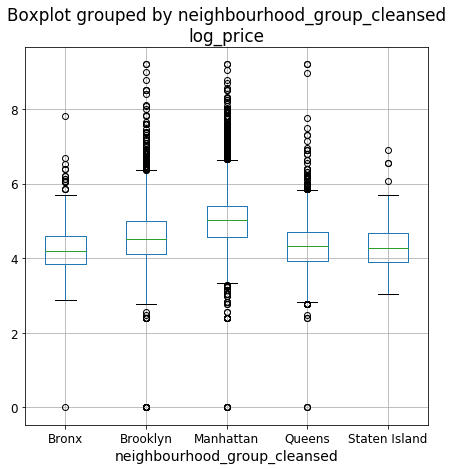

In [134]:
# Do prices vary significantly by area
listings.boxplot( column = 'log_price', by = 'neighbourhood_group_cleansed', fontsize= 12, figsize = (7,7))

In [125]:
# Drop unnecessary columns
listings.drop(columns = ['host_listings_count','host_total_listings_count'],inplace=True)

KeyError: "['host_listings_count' 'host_total_listings_count'] not found in axis"

## EDA

* **accommodates, beds, bedrooms** - I expect the 3 to be correlated as they essentially capture the same thing. I can see that 'accommodates' has a lot more variation in values (meaningful values range from 1 to 8), whereas 'beds' only varies between 1 and 4. Similar pattern is observed with 'bedrooms'. Furthermore, for a given value of beds/bedrooms, we can see that accommodates often has 3-4 meaningful bubbles - this extra variation may show some interesting insights. Therefore, we will use 'accommodates' in our analysis.

It might be intuitive to expect that places with more beds/bedrooms will have a higher price as they can accommodate more people. However, the correlations of either of the 3 variables with price is between 0.25 and 0.35. This suggests that we don’t need to normalise price by beds/bedrooms as we don’t have a strong linear relationship and we could lose some useful insight by doing that. 

In [7]:
# Correlations
print(listings['accommodates'].corr(listings['beds']))
print(listings['accommodates'].corr(listings['bedrooms']))
print(listings['beds'].corr(listings['price']))
print(listings['bedrooms'].corr(listings['price']))
print(listings['accommodates'].corr(listings['price']))

0.7670175156308507
0.6286836401025034
0.27561177094024814
0.25586232095597
0.35666778673090516


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f95ab347978>,
      dtype=object)

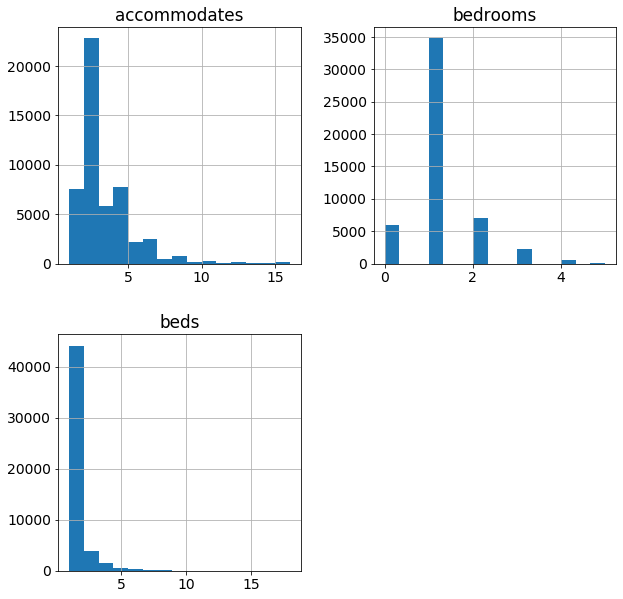

In [146]:
listings[['accommodates', 'bedrooms', 'beds']].hist(figsize = (10,10), bins = 15)

In [148]:
def plot_scatter(df, x1, x2, title=0):
    # create all possible pairs
    a = np.array(np.meshgrid(df[x1].unique(),df[x2].unique())).T.reshape(-1,2)
    a_copy = np.zeros((len(a),1), dtype = int)
    
    for i in range(len(a)):
        # count number of occurrences
        a_copy[i] = df[(df[x1] == a[i][0].astype(int)) &(df[x2] == a[i][1].astype(int))][x1].shape[0]
    
    b = np.concatenate((a, a_copy), axis = 1)
    c = pd.DataFrame(b, columns = [x1, x2, 'count'])
    c = c[c['count'] != 0]

    fig = px.scatter(c, x= x1, y= x2, size = 'count', hover_data=['count'], title=title)
    fig.show()

In [173]:
plot_scatter(listings,'accommodates','beds', "Scatterplot of Accommodates and Beds \n(bubble size shows frequency)")

In [149]:
plot_scatter(listings,'accommodates','bedrooms', "Scatterplot of Accommodates and Bedrooms \n(bubble size shows frequency)")

In [240]:
# Beds = 0 seems to not be Shared Rooms, so it is reasonable to expect at least 1 bed.
listings[listings['beds']==0].groupby('room_type')[['id']].count()

,id
room_type,
1,565
3,424
4,80


In [241]:
# Update 0 values for beds to 1
listings.loc[listings['beds']==0,'beds'] = 1

In [8]:
px.scatter(listings, x='num_neighbours', y = 'log_price', color='room_type')

In [301]:
# Reset Index to take into account deletions
listings.reset_index(inplace=True)

## Venues <a class="anchor" id="venues"></a>

I am interested to see the impact of the venues and their rating in a 1,000 metre radius of each property (i.e. 10-15 min walk).

In [9]:
venues.head()

,city,id,latitude,longitude,name,rating,types
0,new york city,b1a0d113cb17d1d85f0e12700dd71f36bddedc54,40.601540,-73.729636,A Bacon Yacht Charter,NaN,"['restaurant', 'food', 'point_of_interest', 'e..."
1,new york city,8799bb8d8ac7c2e1933f92ac1ef0f69a5e0b37c1,40.608921,-73.728256,Mezzanote,NaN,"['restaurant', 'food', 'point_of_interest', 'e..."
2,new york city,f2390680116af4d62e0da6f0432d33e94b9cb0e6,40.616978,-73.730349,Prime Bistro,4.0,"['bar', 'restaurant', 'food', 'point_of_intere..."
3,new york city,e9294eb56025e8eb29b937dc0aca29fd3059b9ab,40.617318,-73.730637,Rita's Ice,4.6,"['restaurant', 'food', 'point_of_interest', 'e..."
4,new york city,5c7b72c7bf9e7bc4f94baf09db1252088087f65d,40.618371,-73.728178,Cho-Sen Island,4.4,"['restaurant', 'food', 'point_of_interest', 'e..."


In [257]:
# Create Dummy Columns for venue types
venue_list = []
for i in venues['types']:
    for v in i.replace("'","").strip('][').split(', '):
        if v not in venue_list:
            venue_list.append(v)
            
for v in venue_list:
    venues.loc[venues['types'].str.contains(v), v] = 1
    venues.fillna(0, inplace = True)

There are 4,594 food venues with a rating of 0, so it makes sense to remove them as , from a Google search, it is hard even to tell whether they still exist and also it is reasonable to expect that they would not affect the attractiveness of the area for tourists.

Furthermore, of the 4718 entertainment venues, there are 1079 venues with 0 rating, so they will also be removed.

In [252]:
venues.head()

,city,id,latitude,longitude,name,rating,types,restaurant,food,point_of_interest,...,bank,car_rental,embassy,bus_station,taxi_stand,light_rail_station,zoo,subpremise,neighborhood,fire_station
0,new york city,b1a0d113cb17d1d85f0e12700dd71f36bddedc54,40.601540,-73.729636,A Bacon Yacht Charter,0.0,"['restaurant', 'food', 'point_of_interest', 'e...",1.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,new york city,8799bb8d8ac7c2e1933f92ac1ef0f69a5e0b37c1,40.608921,-73.728256,Mezzanote,0.0,"['restaurant', 'food', 'point_of_interest', 'e...",1.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,new york city,f2390680116af4d62e0da6f0432d33e94b9cb0e6,40.616978,-73.730349,Prime Bistro,4.0,"['bar', 'restaurant', 'food', 'point_of_intere...",1.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,new york city,e9294eb56025e8eb29b937dc0aca29fd3059b9ab,40.617318,-73.730637,Rita's Ice,4.6,"['restaurant', 'food', 'point_of_interest', 'e...",1.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,new york city,5c7b72c7bf9e7bc4f94baf09db1252088087f65d,40.618371,-73.728178,Cho-Sen Island,4.4,"['restaurant', 'food', 'point_of_interest', 'e...",1.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [320]:
# Create Groups of venues, excluding those with 0 rating
entertainment_venues = venues[(venues['rating'] != 0) &
                                  (((venues['bar'] ==1 ) & (venues['restaurant'] ==0) & (venues['food']==0)) 
                                    |
                                  ((venues['night_club'] ==1) & (venues['restaurant'] ==0)))].loc[:, 'latitude':'types']
convenience_venues = venues[venues['store'] == 1].loc[:, 'latitude':'types']
food_venues = venues[(venues['rating'] != 0) & (venues['restaurant'] == 1)].loc[:, 'latitude':'types']

In [321]:
# reset index counting
food_venues.reset_index(inplace=True)
entertainment_venues.reset_index(inplace=True)
convenience_venues.reset_index(inplace=True)

In [322]:
# Drop unnecessary index
entertainment_venues.drop(columns=['index'],inplace = True)
food_venues.drop(columns=['index'],inplace = True)
convenience_venues.drop(columns=['index'],inplace = True)

In [323]:
def find_radius_neighbours(df, radius = 1000):
    # Nearest places in a defined radius
    places = df[['longitude','latitude']].to_numpy()
    # define model
    neigh = RadiusNeighborsClassifier(radius = radius, algorithm = 'auto', metric = haversine) 
    neigh.fit(places, np.zeros((len(places),),dtype=int))
    return(neigh)

def venues_rating(row, df):
    return(df[df.index.isin(row)]['rating'].mean())

In [324]:
# add Food_venues indices
closest_venues = find_radius_neighbours(food_venues, 1000)
listings['food_venues'] = listings.apply(lambda x: 
                                         closest_venues.radius_neighbors(x[['longitude','latitude']].to_numpy().reshape(1,-1))[1][0], axis=1)
# add convenience_venues indices
closest_venues = find_radius_neighbours(convenience_venues, 1000)
listings['convenience_venues'] = listings.apply(lambda x: 
                                         closest_venues.radius_neighbors(x[['longitude','latitude']].to_numpy().reshape(1,-1))[1][0], axis=1)
# entertainment venues
closest_venues = find_radius_neighbours(entertainment_venues, 1000)
listings['entertainment_venues'] = listings.apply(lambda x: 
                                         closest_venues.radius_neighbors(x[['longitude','latitude']].to_numpy().reshape(1,-1))[1][0], axis=1)

In [327]:
# Add Mean food_rating / entertainmen_rating
listings['food_rating'] = listings['food_venues'].apply(lambda x: venues_rating(x, food_venues))
listings['entertainment_rating'] = listings['entertainment_venues'].apply(lambda x: venues_rating(x, entertainment_venues))

In [477]:
# Count # of neighbours
listings['num_food'] = listings.apply(lambda x: x['food_venues'].shape[0], axis = 1) 
listings['num_entert'] = listings.apply(lambda x: x['entertainment_venues'].shape[0], axis = 1) 
listings['num_conv'] = listings.apply(lambda x: x['convenience_venues'].shape[0], axis = 1) 

AttributeError: ("'str' object has no attribute 'shape'", 'occurred at index 0')

In [330]:
# Update values for empty venues
listings.loc[listings[listings['food_rating'].isna()].index.values,['food_rating','num_food']] = 0
listings.loc[listings[listings['entertainment_rating'].isna()].index.values,['entertainment_rating','num_entert']] = 0
listings.loc[listings[listings['num_conv']==-1].index.values,'num_conv'] = 0

## Amenities<a class="anchor" id="amenities"></a>

In [331]:
amenities_list = list(listings.amenities)
# convert to string
amenities_list_string = " ".join(amenities_list)
amenities_list_string = amenities_list_string.replace('{', '')
amenities_list_string = amenities_list_string.replace('}', ',')
amenities_list_string = amenities_list_string.replace('"', '')
amenities_set = [x.strip() for x in amenities_list_string.split(',')]
amenities_set = set(amenities_set)
# Show all possible amenities
amenities_set

{'',
 '24-hour check-in',
 'Accessible-height bed',
 'Accessible-height toilet',
 'Air conditioning',
 'Air purifier',
 'BBQ grill',
 'Baby bath',
 'Baby monitor',
 'Babysitter recommendations',
 'Bathtub',
 'Bathtub with bath chair',
 'Beach essentials',
 'Beachfront',
 'Bed linens',
 'Breakfast',
 'Building staff',
 'Buzzer/wireless intercom',
 'Cable TV',
 'Carbon monoxide detector',
 'Cat(s)',
 'Ceiling hoist',
 'Changing table',
 'Children’s books and toys',
 'Children’s dinnerware',
 'Cleaning before checkout',
 'Coffee maker',
 'Cooking basics',
 'Crib',
 'Disabled parking spot',
 'Dishes and silverware',
 'Dishwasher',
 'Dog(s)',
 'Doorman',
 'Dryer',
 'EV charger',
 'Electric profiling bed',
 'Elevator',
 'Essentials',
 'Ethernet connection',
 'Extra pillows and blankets',
 'Family/kid friendly',
 'Fire extinguisher',
 'Fireplace guards',
 'Firm mattress',
 'First aid kit',
 'Fixed grab bars for shower',
 'Fixed grab bars for toilet',
 'Flat path to front door',
 'Free parking

There are a lot of amenities used in the properties. However, my intuition is that things like balcony, lockbox, elevator are much more important than ,say, crib or EV charger in positively affecting price. Therefore, I will combine some of these amenities in the following groups:
* **ease_of_access** - 24-hour check-in, Elevator, Family/kid friendly, Free parking on premises, Free street parking, Paid parking off premises, Paid parking on premises, Self check-in
* **secure** - Lockbox, Lock on bedroom door
* **air_con** - Air conditioning
* **breakfast** - Breakfast
* **tv** - Cable TV, TV
* **white_goods** - Cooking basics, Dishwasher, Washer / Dryer, Washer, Dryer
* **outdoor_space** -  Garden or backyard, Patio or balcony
* **pets_friendly** - Pets live on this property, Pets allowed, Dog(s),Cat(s)
* **smoking_allowed** - Smoking allowed
* **accessible** -  Wheelchair accessible, Step-free shower, Accessible, Disabled parking spot

In [332]:
# Create Amenities groups columns
listings.loc[listings['amenities'].str.contains('24-hour check-in|Elevator|Family/kid friendly|Free parking on premises|Free street parking|Paid parking off premises|Paid parking on premises|Self check-in'), 'ease_of_access'] = 1
listings.loc[listings['amenities'].str.contains('Lockbox|Lock on bedroom door'),'secure'] =1
listings.loc[listings['amenities'].str.contains('Air conditioning'),'air_con'] =1
listings.loc[listings['amenities'].str.contains('Breakfast'),'breakfast'] =1
listings.loc[listings['amenities'].str.contains('Cable TV|TV'),'tv'] =1
listings.loc[listings['amenities'].str.contains('Cooking basics|Dishwasher|Washer / Dryer|Washer|Dryer'),'white_goods'] =1
listings.loc[listings['amenities'].str.contains('Garden or backyard|Patio or balcony'),'outdoor_space'] =1
listings.loc[listings['amenities'].str.contains('Pets live on this property|Pets allowed|Dog(s)|Cat(s)'),'pets_friendly'] =1
listings.loc[listings['amenities'].str.contains('Smoking allowed'),'smoking_allowed'] =1
listings.loc[listings['amenities'].str.contains('Wheelchair accessible|Step-free shower|Accessible|Disabled parking spot'),'accessible'] =1

//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: UserWarning:

This pattern has match groups. To actually get the groups, use str.extract.



In [340]:
# Replace NaN with 0 for new columns
listings[listings.loc[:,'ease_of_access':].columns] = listings[listings.loc[:,'ease_of_access':].columns].fillna(0)

## Map<a class="anchor" id="map"></a>

In [154]:
# Map of NYC
fig = px.scatter_mapbox(listings, lat="latitude", lon="longitude", hover_name="neighbourhood", hover_data=[ 'id','zipcode','neighbourhood_cleansed','neighbourhood_group_cleansed'],
                        color_discrete_sequence=['fuchsia'], zoom=10, height=600,opacity =0.3) 
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()



It would be interesting to see how competitive pricing is, by counting how many other Airbnb properties are located nearby. How much would the presence of other properties compare to other features?

As we have more than 50,000 properties , if we use the naive approach to calculate nearest neighbours by looping through each property and calculating all 50,000 possible pairs, we get $50,000^2$ calculations, which is quite intensive. Due to this issue, we could use the **K-D Tree** algorithm which saves on explicitly calculating distances for each possible pair by using the intuition that if point A is very far from point B, and point B is very close to point C, then we know that A and C are far from each other. Also, KD Tree is sufficient as we only use 2D features of the data (longitude and latitude). On the other hand, the problem is that K-D Tree does not support user-defined metric functions, so I need to stick to "auto" algorithm.

As the data is not uniformly sampled and there is a large concentration of properties in Manhattan, a better approach to finding nearest neighbours is to use a fixed radius rather than a particular number of nearest neighbours. This allows for properties to really be compared like-for-like, in that properties in sparser regions may have fewer neighbours in case there aren't many properties around, and not compared to ,say, the 5 properties on the other side of the river. I think it is reasonable to think that people would consider all properties in a 1,250 metre radius (~15 min walk), so it would be good to see whether prices of neighbouring properties determine the price of a property.

In [12]:
# Nearest Properties in a defined radius
properties = listings[['longitude','latitude']].to_numpy()
# define model
neigh = NearestNeighbors(radius = 1250, algorithm = 'auto', metric = haversine) 
neigh.fit(properties)

NearestNeighbors(metric=<function haversine at 0x7f7ff87e5378>, radius=1250)

In [51]:
# Find nearest neighbours for your dataset
# NOT RECOMMENDED TO RUN AGAIN AS VERY TIME-CONSUMING
listings['nearest_prop'] = listings.apply(lambda x: neigh.radius_neighbors(x[['longitude','latitude']].to_numpy().reshape(1,-1))[1][0], axis=1)

In [53]:
# Count # of neighbours
listings['num_neighbours'] = listings.apply(lambda x: x['nearest_prop'].shape[0]-1, axis = 1) # subtract 1 as each entry includes itself

# SAVE File to not run time-consuming commands again
listings.to_csv("listings_neighbours.csv", index = False)

In [68]:
print('Number of properties with missing\n beds ',listings[listings['beds'].isna()].shape[0],'\n bedrooms ',listings[listings['bedrooms'].isna()].shape[0])

Number of properties with missing
 beds  42 
 bedrooms  42


As these are very few, I will set the missing values to 1, so that I can proceed with the analysis. Also it makes sense to set all those properties referring to "studio" to have 0 bedrooms.

In [69]:
# Set mising values to 1
listings.loc[listings['bedrooms'].isna(),'bedrooms'] = 1
listings.loc[listings['beds'].isna(),'beds'] = 1

In [70]:
# Set studios to have 0 bedrooms
listings.loc[listings['name'].str.contains('Studio|studio',na=False),'bedrooms']=0

As well as counting all the nearby properties, a more insightful measure could be the count of properties with the same room_type and same number of beds to allow a more like-for-like comparison.

In [7]:
def nearby_prop_stats(row, stat = 'mean', filt = 'same'):
    """ return summary statistics for nearby properties"""
    # only compare to identical neighbours
    if filt == 'same':
        # by default return price
        if stat =='mean':
            return(listings[(listings.index.isin(listings.loc[row,'nearest_prop'])) &
                     (listings['beds'] == listings.loc[row,'beds']) &
                     (listings['room_type'] == listings.loc[row,'room_type'])]['log_price'].mean())
        # if want to return count of identical neighbouring properties
        else:
            return(listings[listings.index.isin(listings.loc[row,'nearest_prop']) &
                     (listings['beds'] == listings.loc[row,'beds']) &
                     (listings['room_type'] == listings.loc[row,'room_type'])]['log_price'].shape[0])
    # take mean price of ALL neighbours
    else:
        return(listings.iloc[listings.loc[row,'nearest_prop']]['log_price'].mean())
        

In [72]:
# Calculate Price / No. Neighbours for same type
for i in range(len(listings)):
    listings.loc[i,'neighbour_price_same'] = nearby_prop_stats(i)
    listings.loc[i,'same_neighbour_count'] = nearby_prop_stats(i,'count')
    listings.loc[i,'neighbour_price_all'] = nearby_prop_stats(i,filt ='all')

In [74]:
# Save again after time-consuming calculations
listings.to_csv("listings_neighbours.csv", index = False)

## Reviews<a class="anchor" id="reviews"></a>
Reviews seem very concentrated around 9, so there does not seem to be a lot of variation that could explain price difference. It would nevertheless be interesting to see the results.

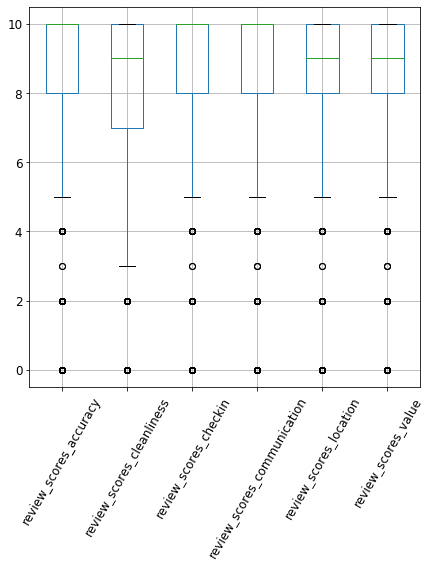

In [161]:
listings.boxplot( column = ['review_scores_accuracy','review_scores_cleanliness','review_scores_checkin','review_scores_communication','review_scores_location','review_scores_value'], rot=60, fontsize= 12, figsize = (7,7))

In [15]:
px.scatter(listings, x = 'review_scores_rating', y='log_price')

## Correlation Matrix<a class="anchor" id="cm"></a>

Text(0.5, 1, 'Pearson Correlation Matrix')

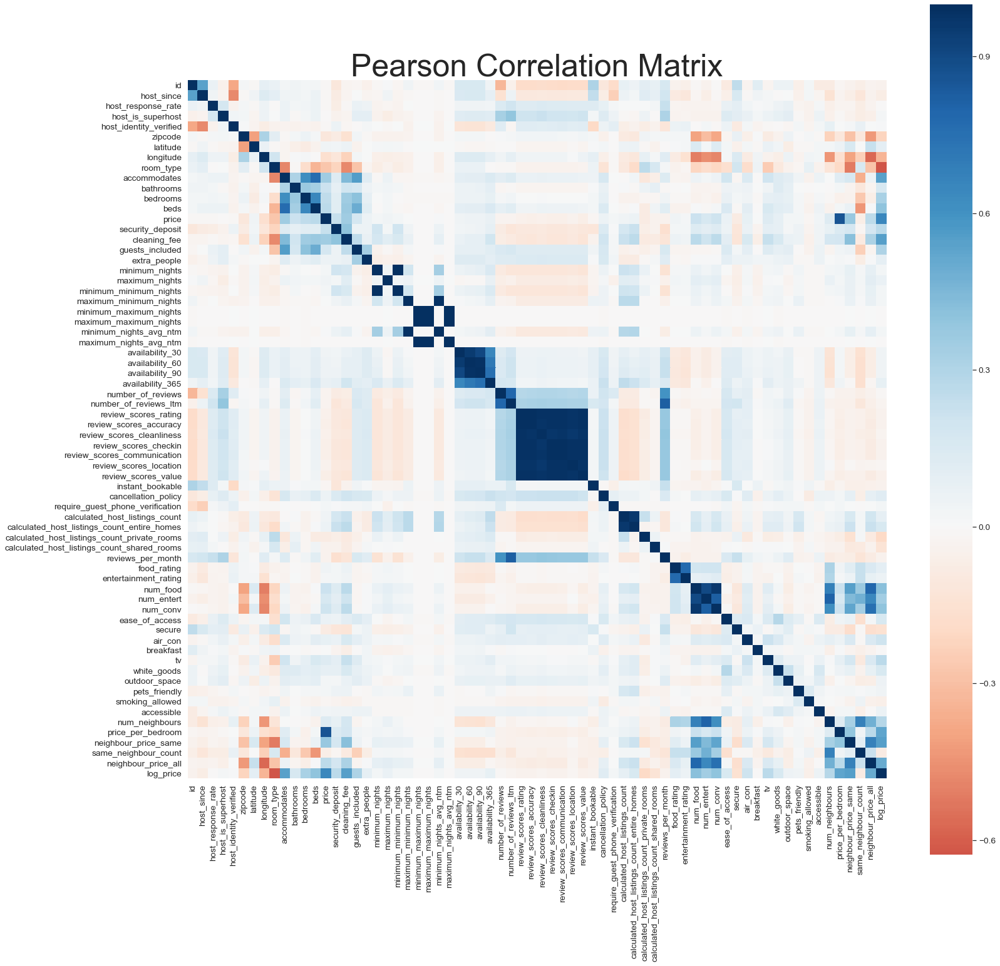

In [198]:
# Correlation Matrix
import seaborn as sns
corrmat = listings.corr()
f, ax = plt.subplots(figsize=(25,25))
sns.heatmap(corrmat,square=True,center=0, vmax = 1, cmap = "RdBu", ax =ax)
ax.set_title('Pearson Correlation Matrix', fontsize = 50)

Before we dive into the models, we can take a quick look at the **Spearman Correlation** heat map. Spearman correlation is a bit more **flexible** as it does **not** assume normal distribution like Pearson and it can also capture non-linear associations as long as they are monotonic (McDonald, 2014). However, the results aren’t that different for Pearson. in this case. Analysing the map, we can make the following observations about

Text(0.5, 1, 'Spearman Correlation Matrix')

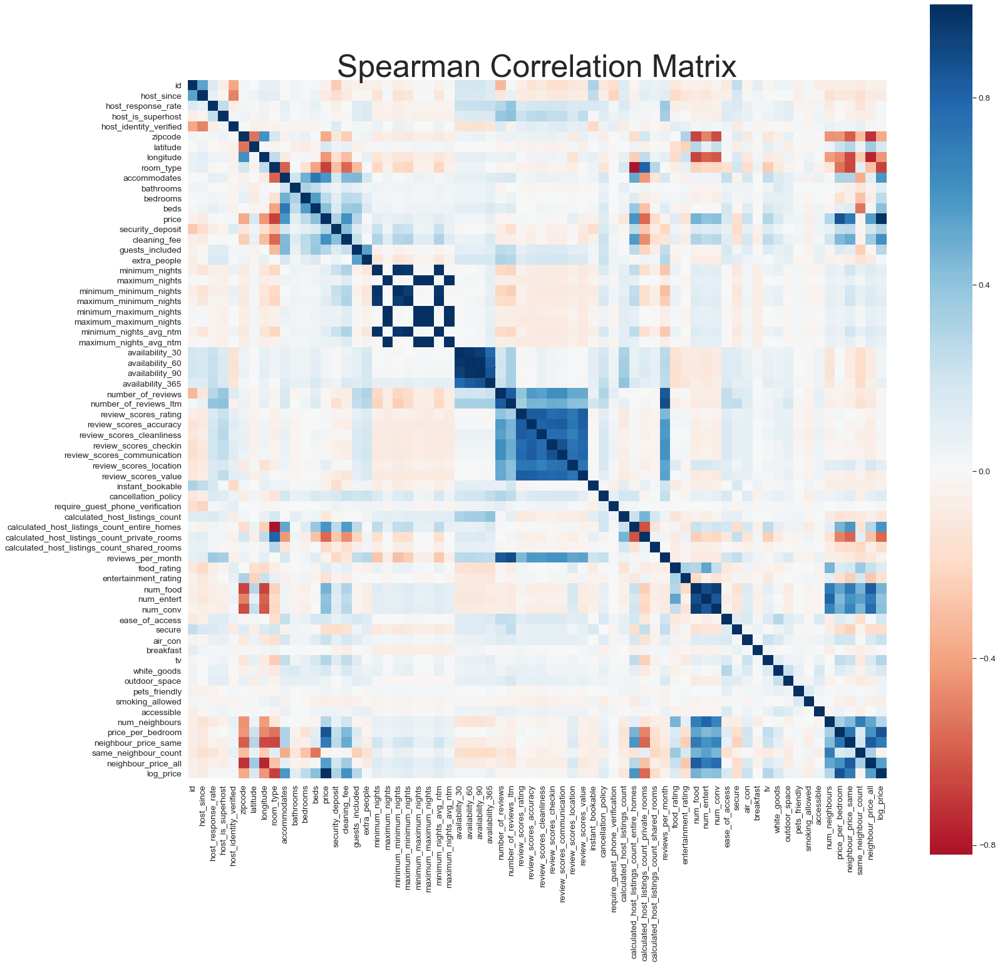

In [199]:
# Spearman Matrix
corrmat = listings.corr(method='spearman')
f, ax = plt.subplots(figsize=(25,25))
sns.heatmap(corrmat,square=True,center=0, vmax = 1, cmap = "RdBu", ax = ax)
ax.set_title('Spearman Correlation Matrix', fontsize = 50)

* **Availability** - values are highly correlated so we can just use one of them (say, availability_90) for our model.
* **Reviews** - all review types are highly correlated so I will just use review_scores_rating.
* **Neighbours** - within 1,250 metre radius, what we observe is that the number of neighbouring properties is positively correlated with the average price.
* **Beds / Bedrooms**
 * Beds and bedrooms are quite strongly, but not perfectly correlated, suggesting that many places have additional beds outside the bedroom.
 * Looking at bedrooms , the lower the number of them, the higher the count of similar properties in a neighbouring radius. This could simply suggest that there are not that many multiple-bedroom places.
* **Zipcode**
 * Larger zip code values (in numerical sense) are associated with lower average values of log_price of the neighbouring properties and with lower number of neighbouring properties. This could mean that larger zipcode values are located further.
 
* **Venues**
 * Interestingly, the number of food, entertainment and convenience venues are highly positively correlated with each other. Perhaps, this is not surprising as we expect to see clusters of venues in specific locations.
 * It is worth noting, that the mean rating for food and entertainment venues are also correlated, which is more surprising as I would expect good-quality venues to be more broadly geographically distributed.
 * Also, we see fewer number of food, entertainment and convenience venues, the larger the zipcode value. 
 * Entire homes and hotel rooms typically have more food, entertainment and convenience venues compared to private and shared rooms. 
 * Another interesting location-based observation is that number of food and entertainment venues is highly positively correlated with the average price in a neighbouring radius - more expensive properties enjoy wider choice of venues.
 * On the other hand, there is no meaningful correlation between price and rating of these venues - thus, good-quality venues are not necessarily located in the expensive areas.
 * The more AirBnB properties there are in a given radius, the more venues one would expect - this could be because most properties are in neighbourhood centres where most venues also are located.
* **Log Price**
 * larger zipcode values negatively correlate with log_price, similarly to longitude. Bearing in mind the negative values for longitude data, this suggests that the further west you get (the more negative longitude value), the higher the price per bedroom.
 * also, the positive, but not perfect, correlation with the mean price of neighbours with same number of bedrooms confirms the expectation that prices are quite competitive, regardless of how many identical properties are inside the radius. This suggests that even if there is a single identical property nearby, the price would be set to be close.

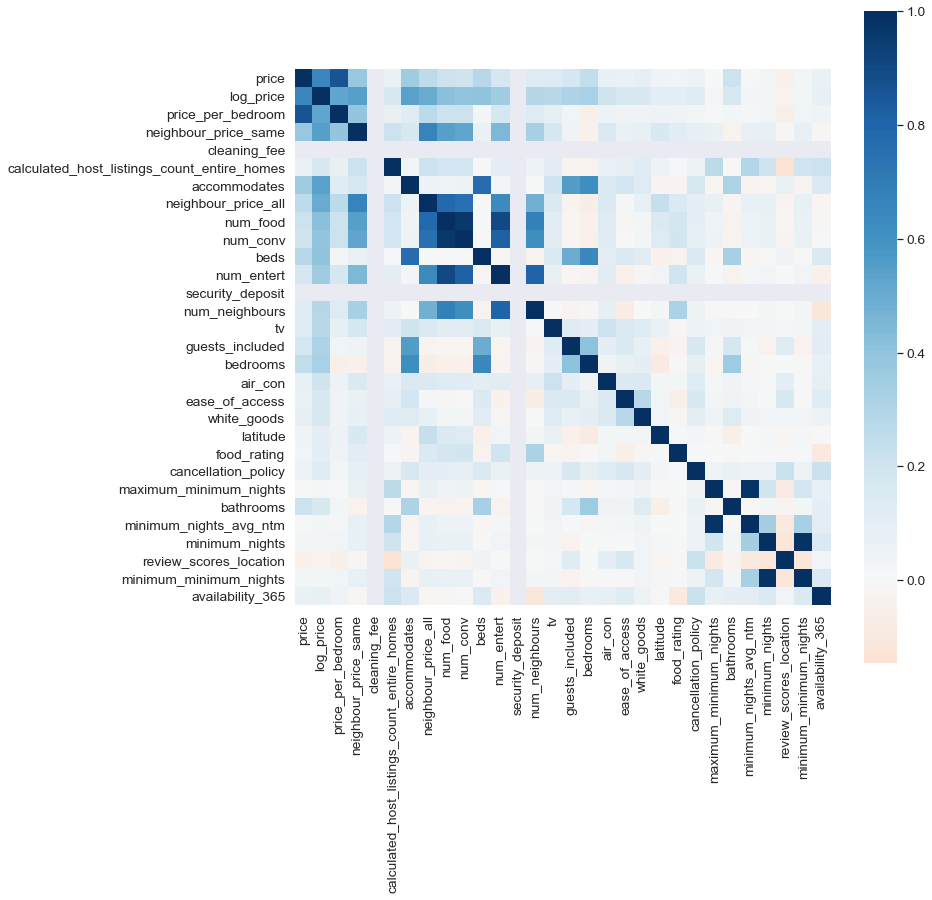

In [202]:
# Top 30 most correlated feature to Log_Price
k = 30
# get Column Names for k largest correlations with SalePrice
cols = corrmat.nlargest(k, 'log_price')['log_price'].index
# corrmat[corrmat['SalePrice']>0.4]['SalePrice'].index

# creates an array of the values for each of the k variables, 
# and calculates the pairwise correlation between each of k variables
cm = np.corrcoef(listings[cols].values.T)
sns.set(font_scale=1.25)
f,ax = plt.subplots(figsize=(12,12))
hm = sns.heatmap(cm, cbar=True, vmax=1,center=0, cmap="RdBu", square = True, fmt='.2f', annot_kws={'size':10},\
                yticklabels=cols.values, xticklabels=cols.values)

plt.show()



## Model Variables<a class="anchor" id="mv"></a>

The purpose of this analysis is to predict price per night based on a range of selected features. We can observe that there is a significant right skew in the distribution of the price per bedroom variable, as there are a couple of extreme values above £1,000 and even a few at £10,000. As many algorithms use a loss function that minimises Mean Squared Error (MSE), what this means is that these extreme values will have a disproportionate influence on the MSE result and the algorithm will try to fit as well as it can to those values. This makes the algorithm fit to more of the noise in the data, rather than the patterns, making it unrepresentative. To avoid this and somewhat improve the skewness issue we can **log-transform** the target variable. This transforms data to look more like a normal distribution and also helps in situations when there is a non-linear relationship between the independent and dependent variables (Benoit, 2011).

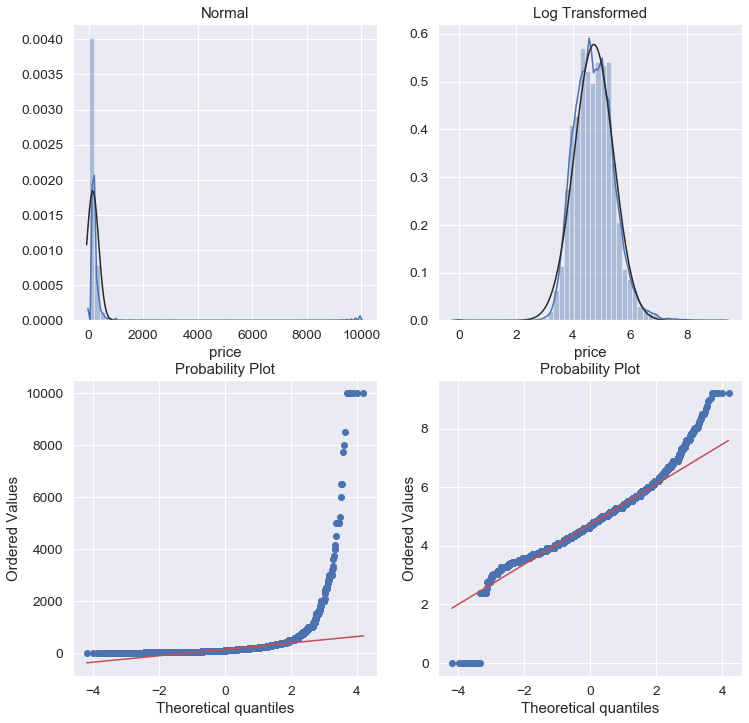

In [203]:
# Histogram
fig, axs = plt.subplots(2,2, figsize=(12,12), sharex=False)
sns.distplot(listings['price'].astype(np.float32), fit=stats.norm, ax = axs[0,0])
axs[0,0].set_title('Normal')
sns.distplot(np.log(listings['price']+1), fit=stats.norm, ax = axs[0,1])
axs[0,1].set_title('Log Transformed')
stats.probplot(listings['price'], plot = axs[1,0])
stats.probplot(np.log(listings['price']+1), plot = axs[1,1])
plt.show()

In [397]:
px.scatter(listings,'minimum_nights','minimum_nights_avg_ntm')

In the end, I will investigate the impact of the following subset of features:
* **host_since** - extract only the year
* **accommodates**
* **zipcode** - I would like to see if using zip code as a numerical variable will help us find some nonlinear patterns with regards to price.
* **maximum nights**
* **host_since, host_is_superhost, host_identity_verified**
* **bathrooms**
* **room_type** - The intuition is the an “entire home” is preferred to a hotel room, which is better than a private room, which is preferred to a shared room. Thus, the variable will have a better chance at being an important split. (Dingwall & Chris, 2016)
* **cancellation_policy**
* **instant_bookable**
* **host_response_rate**
* **venues** - I am interested to find out whether being located near various venues has any explanatory power. I decided to focus on Food (e.g. restaurants), Entertainment (e.g. bars / night clubs) and Convenience venues (i.e. stores), as I imagine many tourists would like to experience the entertainment the city has to offer, and I expect it is a proxy for centrality (more venues being located in the city centre). To do that, I counted all the venues within 1,000 metre-radius of each property along with the mean rating of those.
* **amenities** - because of the large variety of words, I grouped the ones that seem more important into several groups — ease_of_access, secure, air_con, breakfast, tv, white_goods, outdoor_space, pets_friendly, smoking_allowed, accessible. Further details about the grouping can be found in the Appendix.
* **num_neighbours** - I want to find out how competitive pricing is, by counting how many other Airbnb properties are located within a 1,250 metre radius (~15 min
5
walk). As well as counting all nearby properties, I have included a count for properties with the same room_type and same number of beds to allow a more like-for-like comparison. Details in the Appendix
* **neighbour_price** - along with the count of nearby properties, I have calculated the mean price for all properties and those with identical type / number of beds.
* **calculated_host_listings_count**
* **review_scores**
* **minimum_nights**
* **maximum_nights**
* **availability_90** - availability over the next 90 days. A property could be unavailable because it is booked, or because it has not been offered on that date.

In [8]:
# not include security_deposit, cleaning fee as lots of missing values
# no prop_type - predominantly apartments
# no minimum_nights_avg_ntm due to outliers
X = listings[['host_since','host_response_rate','host_is_superhost',
              'host_identity_verified','zipcode', 'room_type','accommodates',
              'guests_included',
              'bathrooms','minimum_nights', 'maximum_nights','availability_90',
              'number_of_reviews_ltm','review_scores_rating', 'instant_bookable',
              'cancellation_policy', 'calculated_host_listings_count',
              'food_rating', 'entertainment_rating', 'num_food', 'num_entert',
              'num_conv', 'ease_of_access', 'secure', 'air_con', 'breakfast', 'tv',
              'white_goods', 'outdoor_space', 'pets_friendly', 'smoking_allowed',
              'accessible','num_neighbours','neighbour_price_all', 
              'neighbour_price_same', 'same_neighbour_count']]
y = np.log(listings[['price']]+1)

In [9]:
# Create Train / Test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=True, random_state = 42)

## Decision Tree<a class="anchor" id="dt"></a>

One possible approach to analyse what influences prices is a decision tree. There are many advantages to use them such as their interpretability - following an intuitive hierarchical tree where one could evaluate the different features of a sample and see at which end node the sample fits. They are also nonlinear and nonparametric models that allow exploring a wide range of relationships that need to be manually modelled in traditional models like regression.

A Decision Tree Regression tries to split each region in such a way that the data points on each side are as close as possible to each other. The decision boundaries are orthogonal, i.e. perpendicular, to an axis.

It is important to note that a decision tree model would keep splitting ever smaller regions until each node contains a single observation. The result would be that there will be no bias in such a model. The problem of letting this happen is that, with fewer samples, in each new region, the tree stops capturing the patterns and begins to fit more of the noise in the data, i.e. the model starts to overfit and will not generalise well on unseen data. This is because the nodes further down in this tree would be very sensitive to little changes in observations which would lead a prediction to follow a very different path, and hence resulting in high variance. This is the well-known Bias-Variance Trade- off inherent in all statistical models - the more complicated the model, the lower the bias, but the higher the variance, i.e. the less likely it is to generalise well.

To tackle this problem, we need to define when to stop the growth of the tree, which is done through various hyper-parameters (max depth, minimum number of samples required to split an internal node, minimum number of samples required to be at a leaf node etc). For this project, I have decided to select a maximum depth of the tree, after which no more splits are done.

Rather than randomly selecting a number for maximum depth, a better approach would be to perform cross validation (picture from https://scikit-learn.org/stable/_images/grid_search_cross_validation.png). This method re-samples the data many times - for example 5-fold Cross Validation fits a given model on 80% of the training data and then evaluates that same model on the remaining 20% of the data. As a given model is evaluated 5 times on a test set not observed during training, we can calculate a given model's average performance on a test set, and use that as a measure of how well this model fits the data. Then, by evaluating many models with various hyperparameter values, we can plot the average test scores and see which one performs best. Cross validation is a resampling technique that overcomes insufficient sample size and aims to increase generalisation ability of a model (Berrar, 2018).

In [188]:
def run_cv_on_trees(X, y, tree_depths, cv=5, scoring='r2'):    
    cv_scores_list = []
    cv_scores_std = []
    cv_scores_mean = []
    accuracy_scores = []
    for depth in tree_depths:
        tree_model = DecisionTreeRegressor(max_depth=depth)
        cv_scores = cross_val_score(tree_model, X, y, cv=cv, scoring=scoring)
        if scoring != 'r2':
            # Function returns negative values for MSE (so higher is better)
            # better to flip to positive and convert to RMSE
            cv_scores_list.append(np.sqrt(np.negative(cv_scores)))
            cv_scores_mean.append(np.sqrt(np.negative(cv_scores)).mean())
            cv_scores_std.append(np.sqrt(np.negative(cv_scores)).std())
        else:
            cv_scores_list.append(cv_scores)
            cv_scores_mean.append(cv_scores.mean())
            cv_scores_std.append(cv_scores.std())
        accuracy_scores.append(tree_model.fit(X, y).score(X, y))
    cv_scores_mean = np.array(cv_scores_mean)
    cv_scores_std = np.array(cv_scores_std)
    accuracy_scores = np.array(accuracy_scores)
    return cv_scores_mean, cv_scores_std, accuracy_scores

def plot_cv_on_trees(metric, depths, cv_scores_mean, cv_scores_std, accuracy_scores, title):
    fig, ax = plt.subplots(1,1, figsize=(15,5))
    ax.plot(depths, cv_scores_mean, '-o', label='mean cross-validation ' + metric, alpha=0.9)
    ax.fill_between(depths, cv_scores_mean-2*cv_scores_std, cv_scores_mean+2*cv_scores_std, alpha=0.2)
    ylim = plt.ylim()
    ax.plot(depths, accuracy_scores, '-*', label='train ' + metric, alpha=0.9)
    ax.grid()
    ax.set_title(title, fontsize=16)
    ax.set_xlabel('Tree depth', fontsize=14)
    ax.set_ylabel(metric, fontsize=14)
    ax.set_ylim(ylim)
    ax.set_xticks(depths)
    ax.legend()

In [228]:
# fitting trees of depth 1 to 24
tree_depths = range(1,25)
# Default Scoring Metric is R2
cv_scores_mean, cv_scores_std, accuracy_scores = run_cv_on_trees(X_train, y_train, tree_depths)

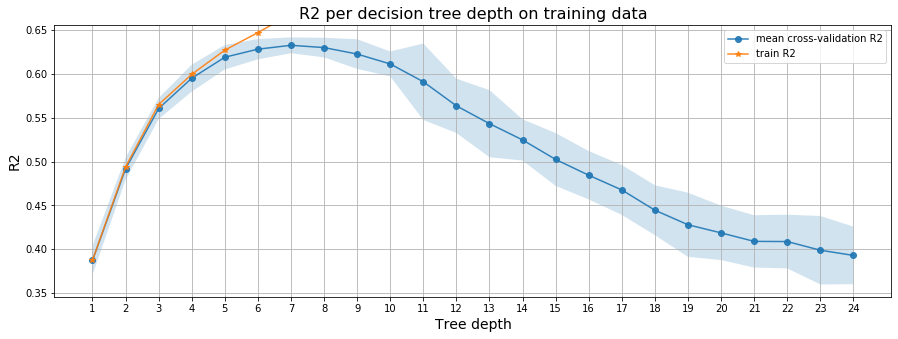

In [229]:
# plotting accuracy
plot_cv_on_trees('R2', tree_depths, cv_scores_mean, cv_scores_std, accuracy_scores, 
                               'R2 per decision tree depth on training data')

In [230]:
# Evaluating score to MSE
cv_scores_mean, cv_scores_std, accuracy_scores = run_cv_on_trees(X_train, y_train, tree_depths, scoring = 'neg_mean_squared_error')

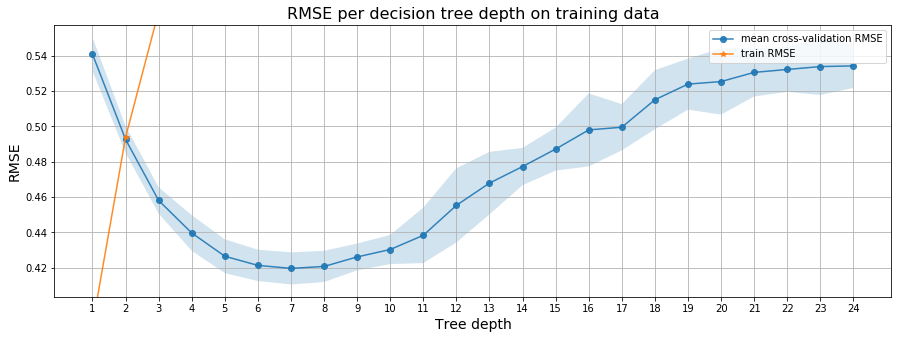

In [231]:
# plotting accuracy on MSE
plot_cv_on_trees('RMSE', tree_depths, cv_scores_mean, cv_scores_std, accuracy_scores, 
                               'RMSE per decision tree depth on training data')

The results from cross-validation show that RMSE is minimised at  `depth=7` , giving an average $R^2$  of 63%. This is supposedly the depth that gives the best balance for the Bias- Variance tradeoff. As a reminder, $R^2$ is the percentage of variation in the dependent variable, price, that is "explained" by the variation in the independent variables included in the model.

$R^2 = \frac{TSS-RSS}{TSS}$ 

TSS - Total Sum of Squares, i.e. the total variation/variance of price 

RSS -Residual Sum of Squares, the square of the residuals from a fitted model. 

So , in the numerator, we have the amount of error that is reduced by using the model compared to simply predicting the average value, and by dividing by total variance, we get the fraction of the error that is decreased by regression compared to the mean line.

Fitting the tree with the best depth on our dataset gives the following results:

In [232]:
dec_tree = DecisionTreeRegressor(criterion = 'mse',max_depth = 7)
dec_tree.fit(X_train,y_train)

DecisionTreeRegressor(criterion='mse', max_depth=7, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')

In [233]:
print("\nTraining RMSE: ", round(np.sqrt(metrics.mean_squared_error(y_train, dec_tree.predict(X_train))),3))
print("Test RMSE: ", round(np.sqrt(metrics.mean_squared_error(y_test, dec_tree.predict(X_test))),3))
print("\nTrain R2: ", round(dec_tree.score(X_train, y_train),4))
print("Test R2: ", round(dec_tree.score(X_test, y_test),4))


Training RMSE:  0.398
Test RMSE:  0.413

Train R2:  0.6684
Test R2:  0.6402


As the dependent variable is log-transformed, the interpretation of RMSE is not straightforward. Transforming it suggests that the **average** prediction is off by a factor of 1.51, in either direction, from the actual value

$0.413 =  \sqrt{\frac{1}{N}\sum_i^N{\big(ln(Predicted)-ln(Actual)\big)^2}}  \\ 0.413^2 = \overline{ln\big(\frac{Predicted}{Actual}\big)^2}  \\  \\
e^{0.413} = \overline{\frac{Predicted}{Actual}} \\
1.51 = \overline{\frac{Predicted}{Actual}}$ 

## Feature Importance <a class="anchor" id="fi1"></a>
**Feature importance** shows how much RSS is reduced in a tree node that uses a split on a particular variable. The results confirm the hypothesis that price setting is highly influenced by the room type (whether it is entire flat, a private room etc). Also, we can see that the average price of all properties in a radius is also very important, and even more so than the price of neighbouring properties with the same number of beds and the same type. Thus, price-setting is a highly competitive process. The number of bathrooms is the next most important feature followed by number of people the property can accommodate. The last meaningful feature is the availability of the property over the next 90 days.

Text(0.5, 1.0, 'Feature Importance')

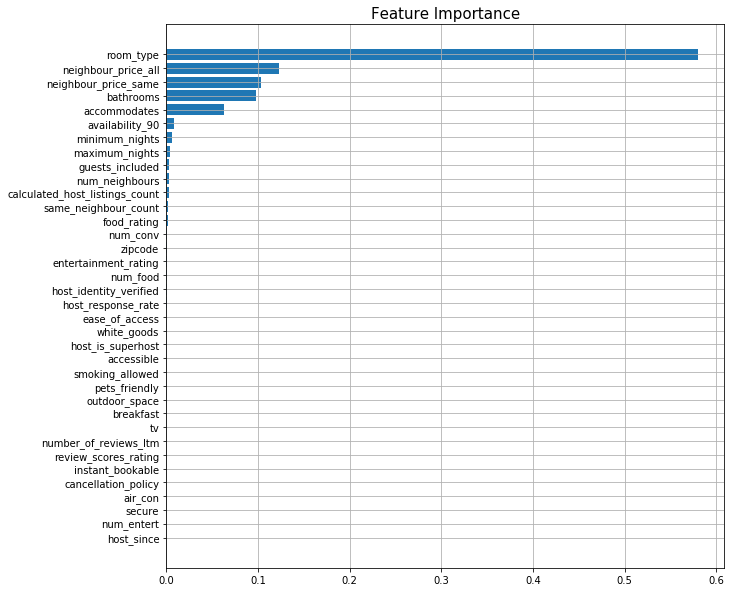

In [234]:
# Feature Importance
dec_tree_feat_imp = pd.DataFrame(dec_tree.feature_importances_, columns = ['weights'], index = X_train.columns).sort_values('weights',)
fig, ax = plt.subplots(1, figsize=(10,10))
ax.grid(zorder=0)
ax.barh(dec_tree_feat_imp.index,dec_tree_feat_imp.weights) 
ax.set_title('Feature Importance', fontdict={'fontsize':'15','fontweight':5})

Looking at the tree itself, it is interesting to note that for Private and Shared rooms, the price of identical neighbouring properties is much more important than for entire flats/ hotel rooms, for which the price of all neighbouring properties is a more differentiating factor. On the other hand, for the latter 2 types of properties, the number of bathrooms is the most important factor, suggesting there is a price premium on bathrooms. Furthermore, with a single bathroom, an entire flat benefits from a price premium when it can accommodate more than 5 people.

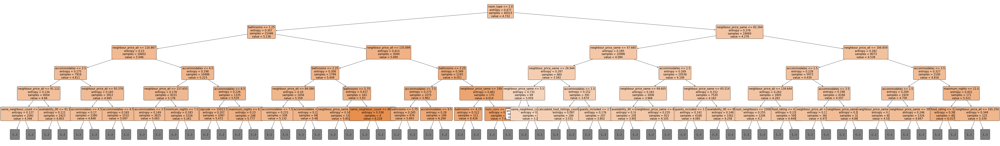

In [273]:
plt.figure(figsize=(100,15))
plot_tree(dec_tree, feature_names = X_train.columns, max_depth=5, filled=True, impurity=True, fontsize= 15, rounded=True) #impurity=True, filled=True, fontsize=50, rounded=True)
# plt.set_title('AirBnB Decision Tree', fontdict={'fontsize':70,'fontweight':5})
plt.savefig('decision_tree.png')
plt.show()

In [81]:
def plot_pred_actual(y_train_pred, y_test_pred, model, y_train=y_train, y_test = y_test):
    # Scatter plot of Predicted vs Actual
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,5))
    fig.suptitle('Predicted vs Actual prices - '+ model, fontsize = 13, y = 1)
    
    ax1.scatter(y_train, y_train_pred, alpha = 0.5)
    ax1.plot(list(range(0,10)), list(range(0,10)), color='black', linestyle='--')
    ax1.set_title("Train set")
    ax1.set_xlabel('Actual')
    ax1.set_ylabel('Predicted')
    
    ax2.scatter(y_test, y_test_pred, alpha = 0.5)
    ax2.plot(list(range(0,10)), list(range(0,10)), color='black', linestyle='--')
    ax2.set_title("Test set")
    ax2.set_xlabel('Actual')
    ax2.set_ylabel('Predicted')
    
    plt.show()

Looking at a **scatterplot** of the predicted and actual values, we can see that there are errors in both the low and high ranges but the model deals particularly badly with the large values, under-predicting them by a significant amount.

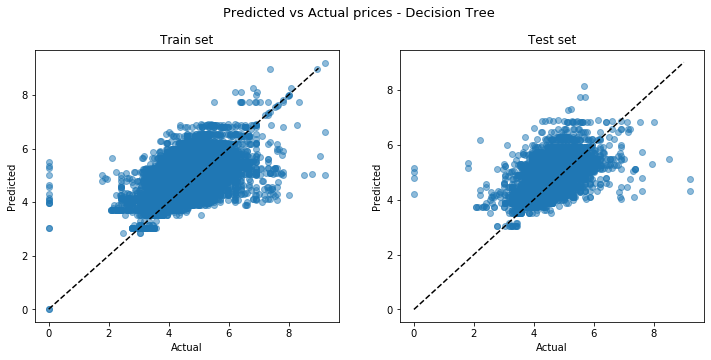

In [236]:
plot_pred_actual(dec_tree.predict(X_train) , dec_tree.predict(X_test), 'Decision Tree')

## XGBoost<a class="anchor" id="xgb"></a>

Having observed the rather poor performance of a single decision tree, and especially the poor predictions on large values, we can attempt a different technique, called Boosted Trees. The idea is that rather than fitting a single tree, we fit a succession of trees, in such a way that each consecutive tree focuses on the errors (residuals) made by the previous tree. Essentially, each one is trying to correct these errors by trying to better fit to the instances that the predecessor over/underfitted the most. Therefore, the new trees emphasise better fitting the difficult cases, in our case the large values. The idea is that combining the outcome of sufficiently many weak learners, that do a bit better than random guessing and are diverse enough, can generate a strong learner with even higher accuracy than the best classifier in the ensemble (Geron, 2017).

One such technique is XGBoost. Chang (2017) suggests that it already is used at Airbnb to predict lifetime value (LTV) of homes, due to its excellent performance. Initially, one makes the same initial random prediction for every single value in our dataset. The first tree has a single leaf containing all the residuals. We then calculate a Structure / Similarity Score formula (Starmer, 2019; XGBoost Documentation)

$$ Structure/Similarity~Score = \frac{(Sum~of~Residuals)^2}{No.~of~Residuals + \lambda} $$

It is worth noting that residuals are not squared before summing them so that they can cancel out. We then want to find out if we can get a better similarly score by splitting the residuals into 2 groups that are more similar to each other. Can we cluster similar residuals better? When residuals are very different, they cancel each other out and the Similarity score is low, whereas when they are similar, the score is relatively high. To find out whether it is worth splitting a root node, we calculate a Gain number which quantifies how much better we cluster similar residuals by splitting rather than sticking with the root node.

$$ Gain = Similarity_{Left} + Similarity_{Right} - Similarity_{Root} $$

We then compare the Gain number for different thresholds and different variables and choose the split that has the largest gain. We use the predicted residuals from a given tree, scale it by a learning rate and add it to the original prediction. As a result, each following residual is smaller than before, meaning that we are taking a small step towards the actual value. We calculate the new residuals and build a new tree, make a new prediction and so on until residuals are very small.

Running an untuned XGBoost model with default parameters returns:

In [83]:
# Need to convert into DMatrix for XGB
dtrain = xgb.DMatrix(X_train, label = y_train)
dtest = xgb.DMatrix(X_test, label = y_test)

In [84]:
# Parameters to tune for XGB
params_xgb = {
    'max_depth': 6,
    'eta': 0.3,
    'subsample': 1}

params_xgb['eval_metric'] = "rmse"
num_boost_round = 1000

In [243]:
xgb_model = xgb.train(params_xgb, dtrain, num_boost_round=num_boost_round,
                     evals = [(dtest, "Test")], 
                     early_stopping_rounds=10)

[0]	Test-rmse:3.02134
Will train until Test-rmse hasn't improved in 10 rounds.
[1]	Test-rmse:2.13721
[2]	Test-rmse:1.52545
[3]	Test-rmse:1.10714
[4]	Test-rmse:0.82554
[5]	Test-rmse:0.64228
[6]	Test-rmse:0.52918
[7]	Test-rmse:0.46296
[8]	Test-rmse:0.42576
[9]	Test-rmse:0.40470
[10]	Test-rmse:0.39382
[11]	Test-rmse:0.38794
[12]	Test-rmse:0.38492
[13]	Test-rmse:0.38235
[14]	Test-rmse:0.38085
[15]	Test-rmse:0.37981
[16]	Test-rmse:0.37902
[17]	Test-rmse:0.37828
[18]	Test-rmse:0.37792
[19]	Test-rmse:0.37797
[20]	Test-rmse:0.37751
[21]	Test-rmse:0.37728
[22]	Test-rmse:0.37661
[23]	Test-rmse:0.37636
[24]	Test-rmse:0.37637
[25]	Test-rmse:0.37638
[26]	Test-rmse:0.37631
[27]	Test-rmse:0.37612
[28]	Test-rmse:0.37614
[29]	Test-rmse:0.37578
[30]	Test-rmse:0.37579
[31]	Test-rmse:0.37519
[32]	Test-rmse:0.37520
[33]	Test-rmse:0.37550
[34]	Test-rmse:0.37552
[35]	Test-rmse:0.37550
[36]	Test-rmse:0.37550
[37]	Test-rmse:0.37517
[38]	Test-rmse:0.37488
[39]	Test-rmse:0.37466
[40]	Test-rmse:0.37468
[41]	Test-

In [244]:
print("Best Test RMSE: {:.2f} with {} rounds".format(
                 xgb_model.best_score,
                 xgb_model.best_iteration+1))

Best Test RMSE: 0.37 with 48 rounds


In [245]:
# First untuned model
print("\nTraining RMSE: ", round(np.sqrt(metrics.mean_squared_error(y_train, xgb_model.predict(dtrain))),3))
print("Test RMSE: ", round(np.sqrt(metrics.mean_squared_error(y_test, xgb_model.predict(dtest))),3))
print("\nTrain R2: ", round(metrics.r2_score(y_train,xgb_model.predict(dtrain)) ,4))
print("Test R2: ", round(metrics.r2_score(y_test,xgb_model.predict(dtest)),4))


Training RMSE:  0.317
Test RMSE:  0.375

Train R2:  0.7899
Test R2:  0.7043


The first observation is that there is a meaningful improvement in RMSE from 0.413 to 0.375 and in R-squared from 64% to 70% without any tuning.

In [22]:
4**5

1024

## Hyperparameter Tuning <a class="anchor" id="ht1"></a>

XGBoost has quite a few hyperparameters one can tune, which may significantly alter performance. However, testing them naively by iterating through various combinations may quickly add up to a lot of computationally expensive operations - e.g. with 4 parameters and 5 possible values of each , you get $4^5 = 1024$ iterations. A simpler approach would be to choose **pairs** of parameters and tune each pair at a time, with each sequential pair using the tuned parameters from the previous pair.

In [120]:
def xgb_tuning(var1, range1, var2=0, range2=0):
    min_rmse =float("Inf")
    best_params = None

    # if tuning a pair of parameters
    if var2 != 0:
        gridsearch_params = [(x1, x2) for x1 in range1 
                             for x2 in range2]
        for x1, x2 in gridsearch_params:
            print("CV with {}={}, {}={}".format(var1, x1, var2,x2))
            # Update parameters
            params_xgb[var1] = x1
            params_xgb[var2] = x2

            # Run CV
            cv_results = xgb.cv(params_xgb, dtrain, num_boost_round=num_boost_round,
                               seed=42, nfold=5, metrics={'rmse'}, early_stopping_rounds= 10)

            # Update best RMSE
            fold_rmse = cv_results['test-rmse-mean'].min()
            xgb_rounds = cv_results['test-rmse-mean'].argmin()
            print("\tRMSE {} for {} rounds".format(fold_rmse, xgb_rounds))
            if fold_rmse < min_rmse:
                min_rmse = fold_rmse
                best_params = (x1 , x2)
        print("Best parameters: {}, {}, RMSE: {}".format(best_params[0], best_params[1], min_rmse))
    # if tuning a single parameter
    else:
        gridsearch_params = [x1 for x1 in range1]
        for x1 in gridsearch_params:
            print("CV with {}={}".format(var1, x1))
            # Update parameters
            params_xgb[var1] = x1
            # Run CV
            cv_results = xgb.cv(params_xgb, dtrain, num_boost_round=num_boost_round,
                               seed=42, nfold=5, metrics={'rmse'}, early_stopping_rounds= 10)
            # Update best RMSE
            fold_rmse = cv_results['test-rmse-mean'].min()
            xgb_rounds = cv_results['test-rmse-mean'].argmin()
            print("\tRMSE {} for {} rounds".format(fold_rmse, xgb_rounds))
            if fold_rmse < min_rmse:
                min_rmse = fold_rmse
                best_params = x1
        print("Best parameters: {}, RMSE: {}".format(best_params, min_rmse))
    

### max_depth and min_child_weight
The first parameters to tune are max_depth and min_child_weight, which control the architecture of the trees. **Max_depth** is the maximum number of splits allowed for the tree to keep branching out - the deeper the tree, the more intricate relationships it can model, but, on the flipside, it could lead to overfitting as the tree starts fitting to less relevant patterns based on fewer data points. **min_child_weight** on the other hand stops partitioning when the sum of instance weights in a leaf is less than a set value. It essentially requires that each leaf has a minimum number of instances (source XGBoost doc). The larger the value, the more conservative the algorithm.

In the cross validation procedure, we allow each fitted model to build up to 1,000 trees. However, as trees are built sequentially, we can test whether an additional tree improves performance. If the performance does not improve over 10 rounds, we stop the current iteration and move to the next XGBoost tree.

In [246]:
xgb_tuning('max_depth', range(1,12), 'min_child_weight', range(1,12))

CV with max_depth=1, min_child_weight=1


//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:21: FutureWarning:


The current behaviour of 'Series.argmin' is deprecated, use 'idxmin'
instead.
The behavior of 'argmin' will be corrected to return the positional
minimum in the future. For now, use 'series.values.argmin' or
'np.argmin(np.array(values))' to get the position of the minimum
row.



	RMSE 0.39094740000000006 for 340 rounds
CV with max_depth=1, min_child_weight=2
	RMSE 0.390997 for 333 rounds
CV with max_depth=1, min_child_weight=3
	RMSE 0.39159920000000004 for 264 rounds
CV with max_depth=1, min_child_weight=4
	RMSE 0.39060320000000004 for 371 rounds
CV with max_depth=1, min_child_weight=5
	RMSE 0.390848 for 320 rounds
CV with max_depth=1, min_child_weight=6
	RMSE 0.39108319999999996 for 313 rounds
CV with max_depth=1, min_child_weight=7
	RMSE 0.39078120000000005 for 369 rounds
CV with max_depth=1, min_child_weight=8
	RMSE 0.390729 for 361 rounds
CV with max_depth=1, min_child_weight=9
	RMSE 0.39103659999999996 for 312 rounds
CV with max_depth=1, min_child_weight=10
	RMSE 0.39005839999999997 for 468 rounds
CV with max_depth=1, min_child_weight=11
	RMSE 0.38951060000000004 for 628 rounds
CV with max_depth=2, min_child_weight=1
	RMSE 0.3771152 for 369 rounds
CV with max_depth=2, min_child_weight=2
	RMSE 0.37614159999999996 for 414 rounds
CV with max_depth=2, min_chi

	RMSE 0.3773156 for 20 rounds
CV with max_depth=11, min_child_weight=1
	RMSE 0.3831132 for 18 rounds
CV with max_depth=11, min_child_weight=2
	RMSE 0.3835004000000001 for 21 rounds
CV with max_depth=11, min_child_weight=3
	RMSE 0.3821888 for 19 rounds
CV with max_depth=11, min_child_weight=4
	RMSE 0.38094360000000005 for 18 rounds
CV with max_depth=11, min_child_weight=5
	RMSE 0.3814416 for 20 rounds
CV with max_depth=11, min_child_weight=6
	RMSE 0.3814934 for 17 rounds
CV with max_depth=11, min_child_weight=7
	RMSE 0.3808626 for 21 rounds
CV with max_depth=11, min_child_weight=8
	RMSE 0.3800498 for 22 rounds
CV with max_depth=11, min_child_weight=9
	RMSE 0.379718 for 20 rounds
CV with max_depth=11, min_child_weight=10
	RMSE 0.3800804 for 22 rounds
CV with max_depth=11, min_child_weight=11
	RMSE 0.37934100000000004 for 21 rounds
Best parameters: 5, 11, RMSE: 0.3733406


In [85]:
# Update parameters based on results of CV
params_xgb['max_depth'] = 5 
params_xgb['min_child_weight'] =11

### ETA
Another important parameter to consider is the learning rate, which controls the weight of a new tree added to the model, i.e. how much we "correct" the errors from a previous round (Brownlee, 2016).

The lower the learning rate, the lower the importance of the previous tree, so it should increase the chance of convergence at the cost of more iterations. Too small a value may result in a long training process that could make very slow progress, while too large a value could lead to selecting a sub-optimal combination of weights too quickly or an unstable learning process (Brownlee, 2019). Lower learning rate usually requires more trees to be fitted to the model, due to the smaller amount that each tree contributes to correcting the residuals. I tried fitting the model with a range of different learning rates [0.3, 0.2, 0.1, 0.05, 0.01]. In this case, we allow 1,600 trees and the optimal learning rate comes out at 0.05.

Although we allowed up to 1,000 trees to be built, while we were tuning, with our tuned parameters the training stops at 392 rounds. It is important, before we train the model with the final parameters, to set the number of trees to 392 to avoid the possibility of overfitting when it is too large.

In [251]:
num_boost_round = 1600
xgb_tuning('eta', list([0.2,0.1,0.05,0.01]))

CV with eta=0.2


//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:39: FutureWarning:


The current behaviour of 'Series.argmin' is deprecated, use 'idxmin'
instead.
The behavior of 'argmin' will be corrected to return the positional
minimum in the future. For now, use 'series.values.argmin' or
'np.argmin(np.array(values))' to get the position of the minimum
row.



	RMSE 0.3716942 for 136 rounds
CV with eta=0.1
	RMSE 0.370027 for 276 rounds
CV with eta=0.05
	RMSE 0.369664 for 542 rounds
CV with eta=0.01
	RMSE 0.370745 for 1599 rounds
Best parameters: 0.05, RMSE: 0.369664


In [86]:
params_xgb['eta'] = 0.05

In [87]:
# The final dictionary of parameters looks like
params_xgb

{'max_depth': 5,
 'eta': 0.05,
 'subsample': 1,
 'eval_metric': 'rmse',
 'min_child_weight': 11}

In [88]:
num_boost_round = 1000
# Train the model with tuned parameters
xgb_model = xgb.train(params_xgb, dtrain, num_boost_round=num_boost_round,
                     evals = [(dtest, "Test")], 
                     early_stopping_rounds=10)

[0]	Test-rmse:4.08024
Will train until Test-rmse hasn't improved in 10 rounds.
[1]	Test-rmse:3.87873
[2]	Test-rmse:3.68735
[3]	Test-rmse:3.50576
[4]	Test-rmse:3.33315
[5]	Test-rmse:3.16931
[6]	Test-rmse:3.01395
[7]	Test-rmse:2.86640
[8]	Test-rmse:2.72642
[9]	Test-rmse:2.59347
[10]	Test-rmse:2.46738
[11]	Test-rmse:2.34768
[12]	Test-rmse:2.23419
[13]	Test-rmse:2.12645
[14]	Test-rmse:2.02427
[15]	Test-rmse:1.92751
[16]	Test-rmse:1.83581
[17]	Test-rmse:1.74877
[18]	Test-rmse:1.66630
[19]	Test-rmse:1.58827
[20]	Test-rmse:1.51424
[21]	Test-rmse:1.44422
[22]	Test-rmse:1.37789
[23]	Test-rmse:1.31519
[24]	Test-rmse:1.25581
[25]	Test-rmse:1.19973
[26]	Test-rmse:1.14665
[27]	Test-rmse:1.09650
[28]	Test-rmse:1.04912
[29]	Test-rmse:1.00441
[30]	Test-rmse:0.96225
[31]	Test-rmse:0.92256
[32]	Test-rmse:0.88511
[33]	Test-rmse:0.85006
[34]	Test-rmse:0.81701
[35]	Test-rmse:0.78584
[36]	Test-rmse:0.75661
[37]	Test-rmse:0.72924
[38]	Test-rmse:0.70355
[39]	Test-rmse:0.67966
[40]	Test-rmse:0.65723
[41]	Test-

[344]	Test-rmse:0.37073
[345]	Test-rmse:0.37071
[346]	Test-rmse:0.37070
[347]	Test-rmse:0.37069
[348]	Test-rmse:0.37070
[349]	Test-rmse:0.37069
[350]	Test-rmse:0.37068
[351]	Test-rmse:0.37068
[352]	Test-rmse:0.37067
[353]	Test-rmse:0.37063
[354]	Test-rmse:0.37062
[355]	Test-rmse:0.37059
[356]	Test-rmse:0.37057
[357]	Test-rmse:0.37053
[358]	Test-rmse:0.37054
[359]	Test-rmse:0.37053
[360]	Test-rmse:0.37052
[361]	Test-rmse:0.37049
[362]	Test-rmse:0.37050
[363]	Test-rmse:0.37046
[364]	Test-rmse:0.37048
[365]	Test-rmse:0.37046
[366]	Test-rmse:0.37045
[367]	Test-rmse:0.37042
[368]	Test-rmse:0.37041
[369]	Test-rmse:0.37040
[370]	Test-rmse:0.37039
[371]	Test-rmse:0.37038
[372]	Test-rmse:0.37039
[373]	Test-rmse:0.37037
[374]	Test-rmse:0.37037
[375]	Test-rmse:0.37036
[376]	Test-rmse:0.37033
[377]	Test-rmse:0.37035
[378]	Test-rmse:0.37035
[379]	Test-rmse:0.37036
[380]	Test-rmse:0.37033
[381]	Test-rmse:0.37030
[382]	Test-rmse:0.37030
[383]	Test-rmse:0.37028
[384]	Test-rmse:0.37028
[385]	Test-rmse:

In [89]:
print("Best Test RMSE: {:.2f} with {} rounds".format(
                 xgb_model.best_score,
                 xgb_model.best_iteration+1))

Best Test RMSE: 0.37 with 392 rounds


### Saving the model

Before using this model for predictions, we need to retrain it with the final number of iterations we observed, since we initially trained with more rounds than would be optimal. So, we can remove the early_stopping_round.

In [90]:
num_boost_round = xgb_model.best_iteration +1
# Train the model with tuned parameters
xgb_model = xgb.train(params_xgb, dtrain, num_boost_round=num_boost_round,
                     evals = [(dtest, "Test")])

[0]	Test-rmse:4.08024
[1]	Test-rmse:3.87873
[2]	Test-rmse:3.68735
[3]	Test-rmse:3.50576
[4]	Test-rmse:3.33315
[5]	Test-rmse:3.16931
[6]	Test-rmse:3.01395
[7]	Test-rmse:2.86640
[8]	Test-rmse:2.72642
[9]	Test-rmse:2.59347
[10]	Test-rmse:2.46738
[11]	Test-rmse:2.34768
[12]	Test-rmse:2.23419
[13]	Test-rmse:2.12645
[14]	Test-rmse:2.02427
[15]	Test-rmse:1.92751
[16]	Test-rmse:1.83581
[17]	Test-rmse:1.74877
[18]	Test-rmse:1.66630
[19]	Test-rmse:1.58827
[20]	Test-rmse:1.51424
[21]	Test-rmse:1.44422
[22]	Test-rmse:1.37789
[23]	Test-rmse:1.31519
[24]	Test-rmse:1.25581
[25]	Test-rmse:1.19973
[26]	Test-rmse:1.14665
[27]	Test-rmse:1.09650
[28]	Test-rmse:1.04912
[29]	Test-rmse:1.00441
[30]	Test-rmse:0.96225
[31]	Test-rmse:0.92256
[32]	Test-rmse:0.88511
[33]	Test-rmse:0.85006
[34]	Test-rmse:0.81701
[35]	Test-rmse:0.78584
[36]	Test-rmse:0.75661
[37]	Test-rmse:0.72924
[38]	Test-rmse:0.70355
[39]	Test-rmse:0.67966
[40]	Test-rmse:0.65723
[41]	Test-rmse:0.63626
[42]	Test-rmse:0.61666
[43]	Test-rmse:0.5984

[346]	Test-rmse:0.37070
[347]	Test-rmse:0.37069
[348]	Test-rmse:0.37070
[349]	Test-rmse:0.37069
[350]	Test-rmse:0.37068
[351]	Test-rmse:0.37068
[352]	Test-rmse:0.37067
[353]	Test-rmse:0.37063
[354]	Test-rmse:0.37062
[355]	Test-rmse:0.37059
[356]	Test-rmse:0.37057
[357]	Test-rmse:0.37053
[358]	Test-rmse:0.37054
[359]	Test-rmse:0.37053
[360]	Test-rmse:0.37052
[361]	Test-rmse:0.37049
[362]	Test-rmse:0.37050
[363]	Test-rmse:0.37046
[364]	Test-rmse:0.37048
[365]	Test-rmse:0.37046
[366]	Test-rmse:0.37045
[367]	Test-rmse:0.37042
[368]	Test-rmse:0.37041
[369]	Test-rmse:0.37040
[370]	Test-rmse:0.37039
[371]	Test-rmse:0.37038
[372]	Test-rmse:0.37039
[373]	Test-rmse:0.37037
[374]	Test-rmse:0.37037
[375]	Test-rmse:0.37036
[376]	Test-rmse:0.37033
[377]	Test-rmse:0.37035
[378]	Test-rmse:0.37035
[379]	Test-rmse:0.37036
[380]	Test-rmse:0.37033
[381]	Test-rmse:0.37030
[382]	Test-rmse:0.37030
[383]	Test-rmse:0.37028
[384]	Test-rmse:0.37028
[385]	Test-rmse:0.37029
[386]	Test-rmse:0.37028
[387]	Test-rmse:

After tuning these parameters and retraining, the outputs are the following:

In [91]:
# First untuned model
print("\nTraining RMSE: ", round(np.sqrt(metrics.mean_squared_error(y_train, xgb_model.predict(dtrain))),3))
print("Test RMSE: ", round(np.sqrt(metrics.mean_squared_error(y_test, xgb_model.predict(dtest))),3))
print("\nTrain R2: ", round(metrics.r2_score(y_train,xgb_model.predict(dtrain)) ,4))
print("Test R2: ", round(metrics.r2_score(y_test,xgb_model.predict(dtest)),4))


Training RMSE:  0.339
Test RMSE:  0.37

Train R2:  0.7593
Test R2:  0.7112


Overall, we have a marginal improvement in the Test RMSE and R-Squared, but at least we can be more confident that the model won’t be overfitting.

## Feature Importance<a class="anchor" id="fi2"></a>
As it is hard to visualise the hundreds of trees and understand which features were used and which are generally useful, we can look at the **Feature Importance** functionality. For each tree it calculates how much of an improvement each feature split has, weighted by the number of sample points the split is responsible for - in regression case, the improvement is measured by how much RSS decreases with a split (James et al., 2013). After doing this for all features in a given tree, the feature importances are averaged across all trees in the model. The higher the relative importance, the more often a given feature is used in making meaningful splits (i.e. closer to the root of the tree) (Brownlee, 2016).

In [258]:
# save model
xgb_model.save_model("XGB_PricePerBedroom.model")

What we see from the feature importance diagram is pretty much the same order as with the simple decision tree. However, “bathrooms” seems to be the 2nd most important feature based on gain, confirming the earlier finding that there seems to be a significant premium on bathrooms. Interestingly, having a TV and white goods like dishwasher, cooking basics also ranks in top 10. Perhaps what this points to is that it is strange that these properties don’t have these rather basic amenities in the first place.

Text(0.5, 1.0, 'Feature Importance - Gain')

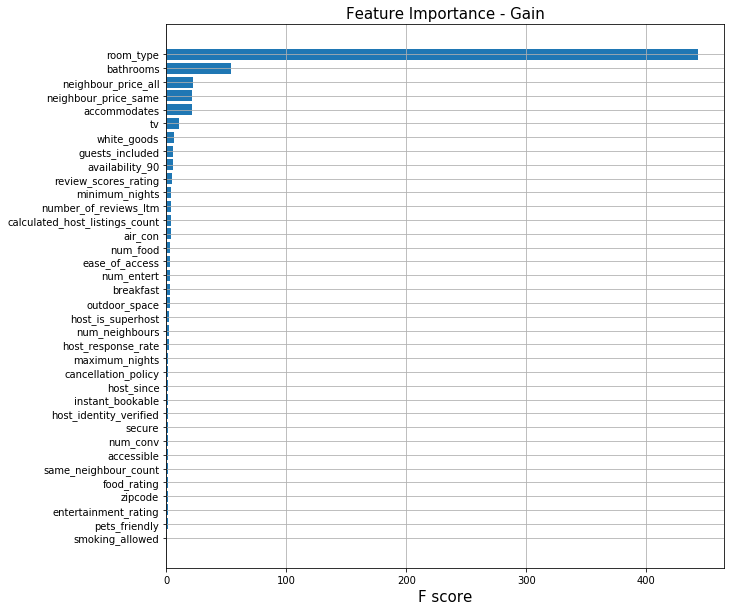

In [298]:
# Feature Importance - Gain
xgb_feat_imp = pd.DataFrame(xgb_model.get_score(importance_type = 'gain').values(), index = xgb_model.get_score(importance_type = 'gain').keys(), columns = ['gain']).sort_values('gain',)
fig, ax = plt.subplots(1, figsize=(10,10))
ax.grid(zorder=0)
ax.barh(xgb_feat_imp.index,xgb_feat_imp.gain) 
plt.xlabel("F score", fontsize=15)
ax.set_title('Feature Importance - Gain', fontdict={'fontsize':'15','fontweight':5})

Another way to analyse XGBoost trees is through the **“weight”** feature, which counts the number of times a feature is used to make a split across all trees (XGBoost, 2020). For example, the number of neighbours is used around 550 times, but its importance in reducing residuals is small, therefore, it seems to be mostly used towards the bottom of the trees.

Text(0.5, 1.0, 'Feature Importance - Weight')

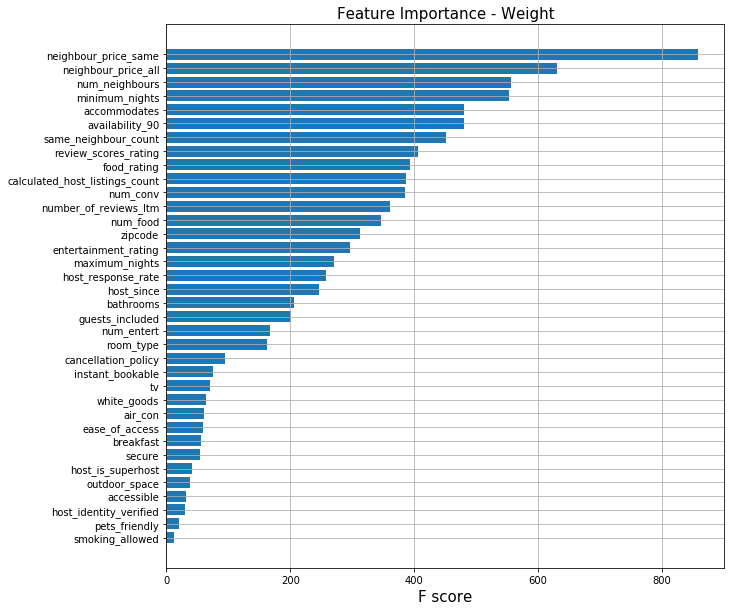

In [300]:
# Feature Importance - Weight
xgb_feat_imp = pd.DataFrame(xgb_model.get_score(importance_type = 'weight').values(), index = xgb_model.get_score(importance_type = 'weight').keys(), columns = ['weight']).sort_values('weight')
fig, ax = plt.subplots(1, figsize=(10,10))
ax.grid(zorder=0)
ax.barh(xgb_feat_imp.index,xgb_feat_imp.weight) 
plt.xlabel("F score", fontsize=15)
ax.set_title('Feature Importance - Weight', fontdict={'fontsize':'15','fontweight':5})

It is useful to look at also which features are **least important**, as this also has interesting insights. Surprisingly, **zip code** seems to almost have no explanatory power. This seems to confirm the finding by Coles et al (2017) that distance from centre does not seem to be an important factor. Similarly, the **rating** of neighbouring entertainment and food venues also does not have an effect on price. Although the **quality** does not seem to matter, **quantity** does to a small extent (as shown by num_food, num_entert)

Looking at how good predictions are, we can see from the scatterplot that values are much tighter and predictions much closer to actual values. Unlike a decision tree, XGBoost predicts much better the very highest prices, which is expected given its error correction approach. On the other hand, we can see there are still significant under predictions for high-priced properties.

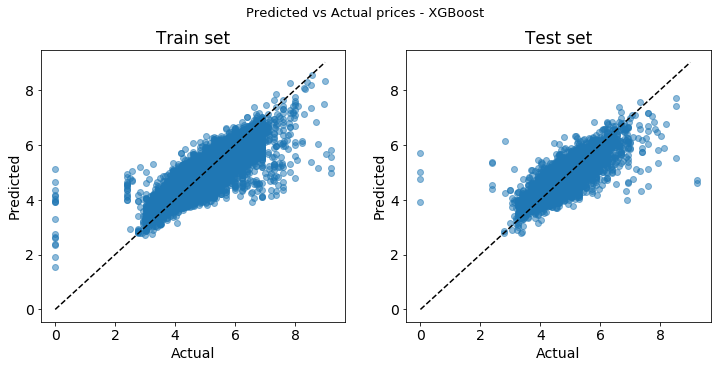

In [93]:
plot_pred_actual(xgb_model.predict(dtrain) ,xgb_model.predict(dtest), 'XGBoost')

## Random Forest<a class="anchor" id="rf"></a>

Another alternative to tackling the overfitting tendency of a single tree is to use Random Forest, which create a collection of trees, with each one being a little bit different. The way to make the trees uncorrelated is by drawing random samples from the data, with replacement, i.e. some data points could be selected multiple times, while others may never be used. In each node, only a subset of features is considered for the next split, and each node could select a different subset of features - this is controlled via the “max_features” hyperparameter, where a high value suggests that the trees will be rather similar to each other, and will fit the data quite well, as they can select the best split from a wide variety of features. In the end, each tree is built on a slightly different dataset and different subset of features. In the process, we are again trading off a higher bias to ensure a lower variance. Breiman (2001) shows that random forests are more robust to noise in the dependent variable.

The parameters that need to be tuned for a Random Forest are:
* **max_depth** - how deep are trees allowed to get. The deeper they get, the more information is captured.
* **n_estimators** - how many different trees to create before averaging out their predictions. The larger the number, the more random variations allowed in the learning process, at the expense of slower training process. The good thing is that one does not get overfitting, but a converging generalisation error with more trees (Breiman, 2001)
* **max_features** - the number of features each node is allowed to look at. This aims to prevent instances when different trees will choose the same very strong predictor at the top of the tree and the trees will end up looking quite similar. Instead, some trees may not have the option of selecting the strong predictor and will have to do with the moderate ones.
* **min_samples_split** - the minimum number/proportion of samples in a node required before a further split is made. A larger number constrains the growth of the tree as more samples are needed in a node.

As there is a lot of possible combinations, my first step would be to take **100 random** combinations of parameter values, use 3-fold CV, and see what the parameters for the best model are. That allows us to then narrow down the ranges of parameters, and use **Grid Search** to calculate all possible combinations, which will hopefully be much smaller and not that time-consuming.

## Hyperparameter Tuning<a class="anchor" id="ht2"></a>

In [5]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV

In [334]:
# range of parameters to tune
rf_params = {
    'max_depth': [2,3,4,5,6,7],
    'n_estimators': [200, 400, 600, 800, 1000, 1200],
    'max_features': ['sqrt' ,0.25, 0.5, 0.75],
    'min_samples_split': [50,100,200,300,500],
}

In [336]:
# base model to tune
rf = RandomForestRegressor()
# random 100 combinations of parameters with 5-fold CV
rf_random = RandomizedSearchCV(estimator = rf, 
                               param_distributions=rf_params, n_iter = 100,
                               cv = 3, verbose = 3, random_state = 42)
# Fit the random search model
rf_random.fit(X_train, y_train)

Fitting 3 folds for each of 100 candidates, totalling 300 fits
[CV] n_estimators=800, min_samples_split=300, max_samples=1, max_features=0.75, max_depth=2 


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


ValueError: Invalid parameter max_samples for estimator RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=300,
                      min_weight_fraction_leaf=0.0, n_estimators=800,
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False). Check the list of available parameters with `estimator.get_params().keys()`.

In [330]:
# Intermediary step to prevent not being able to see the results.
rf_random_1 = rf_random

In [339]:
rf_random_1.best_params_

{'n_estimators': 400,
 'min_samples_split': 50,
 'max_features': 0.5,
 'max_depth': 7}

In [391]:
# DataFrame of CV results
RandSearchCV_df = pd.DataFrame(rf_random_1.cv_results_).sort_values('rank_test_score')
RandSearchCV_df.to_csv('RandomSearchCV_rf.csv')

In [28]:
param_grid = {
    'bootstrap': [True],
    'max_depth':[3,4,5,6,7],
    'n_estimators': [400, 600, 800, 1000],
    'max_features':['sqrt',0.25, 0.5],
    'min_samples_split': [0.01, 0.025, 0.05, 0.1 ]}

rf1 = RandomForestRegressor()

# Instantiate Grid Search Model
grid_search = GridSearchCV(estimator = rf1, param_grid= param_grid, 
                          cv = 3, verbose = 3)

In [29]:
# Fit the grid search to the data
# Takes a lot of time so see results directly
grid_search.fit(X_train, y_train)

Fitting 3 folds for each of 240 candidates, totalling 720 fits
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=400 


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=400, score=0.553, total=   3.1s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=400 


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    3.1s remaining:    0.0s
//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=400, score=0.559, total=   3.1s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=400 


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    6.2s remaining:    0.0s
//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=400, score=0.540, total=   3.2s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=600, score=0.551, total=   4.5s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=600, score=0.553, total=   4.6s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=600, score=0.543, total=   4.5s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=800, score=0.555, total=   6.0s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=800, score=0.556, total=   6.0s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=800, score=0.540, total=   6.0s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=1000, score=0.549, total=   7.5s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=1000, score=0.557, total=   7.5s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.01, n_estimators=1000, score=0.543, total=   7.4s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=400, score=0.550, total=   3.0s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=400, score=0.551, total=   3.0s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=400, score=0.541, total=   3.0s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=600, score=0.554, total=   4.6s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=600, score=0.555, total=   4.4s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=600, score=0.546, total=   4.5s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=800, score=0.552, total=   6.0s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=800, score=0.558, total=   6.0s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=800, score=0.543, total=   6.2s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=1000, score=0.550, total=   7.7s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=1000, score=0.555, total=   7.5s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.025, n_estimators=1000, score=0.541, total=   7.5s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=400, score=0.553, total=   3.0s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=400, score=0.552, total=   3.0s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=400, score=0.537, total=   3.1s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=600, score=0.547, total=   4.5s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=600, score=0.554, total=   4.5s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=600, score=0.541, total=   4.5s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=800, score=0.548, total=   6.2s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=800, score=0.551, total=   6.2s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=800, score=0.540, total=   6.2s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=1000, score=0.546, total=   7.7s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=1000, score=0.552, total=   7.5s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.05, n_estimators=1000, score=0.540, total=   7.5s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=400, score=0.536, total=   3.0s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=400, score=0.546, total=   3.0s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=400, score=0.529, total=   3.0s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=600, score=0.544, total=   4.6s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=600, score=0.546, total=   4.5s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=600, score=0.533, total=   4.8s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=800, score=0.542, total=   6.6s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=800, score=0.542, total=   6.9s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=800, score=0.531, total=   6.2s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=1000, score=0.544, total=   8.2s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=1000, score=0.544, total=   7.6s
[CV] bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=sqrt, min_samples_split=0.1, n_estimators=1000, score=0.534, total=   7.7s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=400, score=0.578, total=   4.5s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=400, score=0.583, total=   4.3s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=400, score=0.573, total=   4.2s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=600, score=0.580, total=   6.3s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=600, score=0.586, total=   6.6s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=600, score=0.571, total=   6.6s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=800, score=0.581, total=   8.4s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=800, score=0.584, total=   8.3s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=800, score=0.571, total=   8.4s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=1000, score=0.581, total=  10.5s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=1000, score=0.585, total=  10.4s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.01, n_estimators=1000, score=0.570, total=  10.3s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=400, score=0.580, total=   4.1s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=400, score=0.582, total=   4.1s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=400, score=0.572, total=   4.1s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=600, score=0.582, total=   6.1s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=600, score=0.584, total=   6.2s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=600, score=0.571, total=   6.4s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=800, score=0.579, total=   8.2s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=800, score=0.584, total=   8.2s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=800, score=0.570, total=   8.2s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=1000, score=0.582, total=  10.3s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=1000, score=0.584, total=  10.2s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.025, n_estimators=1000, score=0.570, total=  10.2s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=400, score=0.578, total=   4.1s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=400, score=0.580, total=   4.0s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=400, score=0.569, total=   4.1s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=600, score=0.578, total=   6.0s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=600, score=0.581, total=   6.1s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=600, score=0.568, total=   6.1s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=800, score=0.578, total=   8.2s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=800, score=0.579, total=   8.0s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=800, score=0.569, total=   8.2s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=1000, score=0.579, total=  10.1s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=1000, score=0.580, total=  10.1s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.05, n_estimators=1000, score=0.568, total=  10.5s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=400, score=0.573, total=   4.0s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=400, score=0.577, total=   4.0s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=400, score=0.564, total=   3.9s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=600, score=0.573, total=   5.9s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=600, score=0.577, total=   5.9s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=600, score=0.564, total=   6.0s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=800, score=0.572, total=   7.9s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=800, score=0.576, total=   7.9s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=800, score=0.563, total=   7.9s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=1000, score=0.573, total=   9.9s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=1000, score=0.575, total=  10.0s
[CV] bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.25, min_samples_split=0.1, n_estimators=1000, score=0.562, total=  10.0s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=400, score=0.602, total=   7.6s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=400, score=0.603, total=   7.6s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=400, score=0.590, total=   7.6s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=600, score=0.603, total=  11.3s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=600, score=0.602, total=  11.9s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=600, score=0.590, total=  11.3s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=800, score=0.602, total=  15.2s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=800, score=0.603, total=  15.1s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=800, score=0.590, total=  15.3s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=1000, score=0.602, total=  18.9s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=1000, score=0.602, total=  19.0s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.01, n_estimators=1000, score=0.590, total=  18.9s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=400, score=0.603, total=   7.6s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=400, score=0.602, total=   7.6s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=400, score=0.590, total=   7.6s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=600, score=0.603, total=  11.4s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=600, score=0.603, total=  11.4s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=600, score=0.590, total=  11.3s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=800, score=0.603, total=  15.2s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=800, score=0.603, total=  15.2s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=800, score=0.590, total=  15.1s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=1000, score=0.603, total=  18.8s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=1000, score=0.602, total=  18.9s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.025, n_estimators=1000, score=0.590, total=  19.0s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=400, score=0.598, total=   7.5s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=400, score=0.600, total=   7.5s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=400, score=0.585, total=   7.7s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=600, score=0.598, total=  11.4s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=600, score=0.601, total=  11.2s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=600, score=0.586, total=  11.3s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=800, score=0.599, total=  15.0s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=800, score=0.601, total=  15.1s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=800, score=0.586, total=  15.0s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=1000, score=0.598, total=  18.7s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=1000, score=0.601, total=  18.7s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.05, n_estimators=1000, score=0.587, total=  18.8s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=400, score=0.594, total=   7.4s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=400, score=0.596, total=   7.3s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=400, score=0.582, total=   7.3s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=600, score=0.595, total=  10.9s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=600, score=0.596, total=  11.0s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=600, score=0.583, total=  10.9s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=800, score=0.595, total=  14.6s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=800, score=0.596, total=  14.6s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=800, score=0.583, total=  14.6s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=1000, score=0.594, total=  18.5s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=1000, score=0.596, total=  18.6s
[CV] bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=3, max_features=0.5, min_samples_split=0.1, n_estimators=1000, score=0.583, total=  18.3s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=400, score=0.594, total=   3.7s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=400, score=0.593, total=   3.8s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=400, score=0.581, total=   3.7s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=600, score=0.594, total=   5.6s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=600, score=0.594, total=   5.6s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=600, score=0.581, total=   5.6s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=800, score=0.593, total=   7.5s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=800, score=0.594, total=   7.5s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=800, score=0.581, total=   7.5s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=1000, score=0.592, total=   9.3s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=1000, score=0.595, total=   9.4s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.01, n_estimators=1000, score=0.581, total=   9.4s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=400, score=0.586, total=   3.8s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=400, score=0.591, total=   3.8s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=400, score=0.579, total=   3.7s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=600, score=0.591, total=   5.6s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=600, score=0.591, total=   5.5s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=600, score=0.579, total=   5.6s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=800, score=0.589, total=   7.4s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=800, score=0.591, total=   7.4s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=800, score=0.578, total=   7.5s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=1000, score=0.590, total=   9.3s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=1000, score=0.593, total=   9.4s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.025, n_estimators=1000, score=0.579, total=   9.3s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=400, score=0.583, total=   3.6s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=400, score=0.586, total=   3.7s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=400, score=0.574, total=   3.6s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=600, score=0.583, total=   5.4s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=600, score=0.586, total=   5.5s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=600, score=0.574, total=   5.5s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=800, score=0.583, total=   7.3s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=800, score=0.587, total=   7.3s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=800, score=0.574, total=   7.3s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=1000, score=0.584, total=   9.1s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=1000, score=0.587, total=   9.1s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.05, n_estimators=1000, score=0.574, total=   9.2s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=400, score=0.566, total=   3.4s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=400, score=0.572, total=   3.4s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=400, score=0.562, total=   3.4s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=600, score=0.567, total=   5.1s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=600, score=0.571, total=   5.1s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=600, score=0.557, total=   5.1s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=800, score=0.570, total=   6.7s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=800, score=0.570, total=   6.6s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=800, score=0.560, total=   6.7s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=1000, score=0.567, total=   8.4s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=1000, score=0.572, total=   8.4s
[CV] bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=sqrt, min_samples_split=0.1, n_estimators=1000, score=0.559, total=   8.4s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=400, score=0.613, total=   5.3s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=400, score=0.615, total=   5.3s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=400, score=0.602, total=   5.3s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=600, score=0.613, total=   8.0s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=600, score=0.615, total=   8.0s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=600, score=0.602, total=   8.0s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=800, score=0.615, total=  10.6s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=800, score=0.614, total=  10.6s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=800, score=0.601, total=  11.2s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=1000, score=0.615, total=  13.2s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=1000, score=0.615, total=  13.2s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.01, n_estimators=1000, score=0.601, total=  13.3s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=400, score=0.612, total=   5.2s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=400, score=0.613, total=   5.5s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=400, score=0.599, total=   5.4s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=600, score=0.612, total=   7.9s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=600, score=0.612, total=   7.9s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=600, score=0.600, total=   7.9s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=800, score=0.612, total=  10.6s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=800, score=0.613, total=  10.5s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=800, score=0.599, total=  10.6s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=1000, score=0.612, total=  13.2s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=1000, score=0.613, total=  13.0s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.025, n_estimators=1000, score=0.599, total=  13.1s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=400, score=0.605, total=   5.2s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=400, score=0.608, total=   5.1s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=400, score=0.594, total=   5.1s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=600, score=0.605, total=   7.7s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=600, score=0.608, total=   7.7s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=600, score=0.595, total=   7.6s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=800, score=0.604, total=  10.2s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=800, score=0.607, total=  10.2s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=800, score=0.594, total=  10.3s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=1000, score=0.605, total=  12.9s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=1000, score=0.608, total=  12.8s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.05, n_estimators=1000, score=0.595, total=  12.8s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=400, score=0.593, total=   4.7s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=400, score=0.594, total=   4.7s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=400, score=0.582, total=   4.7s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=600, score=0.593, total=   7.1s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=600, score=0.596, total=   7.1s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=600, score=0.581, total=   7.1s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=800, score=0.592, total=   9.5s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=800, score=0.596, total=   9.5s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=800, score=0.582, total=   9.5s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=1000, score=0.594, total=  11.8s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=1000, score=0.595, total=  11.8s
[CV] bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.25, min_samples_split=0.1, n_estimators=1000, score=0.582, total=  11.9s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=400, score=0.631, total=   9.9s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=400, score=0.629, total=  10.0s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=400, score=0.615, total=   9.9s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=600, score=0.631, total=  14.9s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=600, score=0.628, total=  15.0s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=600, score=0.615, total=  14.9s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=800, score=0.631, total=  20.0s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=800, score=0.629, total=  20.1s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=800, score=0.615, total=  19.9s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=1000, score=0.631, total=  24.8s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=1000, score=0.628, total=  24.8s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.01, n_estimators=1000, score=0.616, total=  24.9s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=400, score=0.628, total=   9.9s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=400, score=0.626, total=   9.8s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=400, score=0.613, total=   9.9s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=600, score=0.628, total=  14.8s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=600, score=0.625, total=  14.7s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=600, score=0.614, total=  14.7s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=800, score=0.628, total=  19.7s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=800, score=0.625, total=  19.7s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=800, score=0.613, total=  19.8s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=1000, score=0.628, total=  24.7s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=1000, score=0.626, total=  24.6s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.025, n_estimators=1000, score=0.613, total=  24.7s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=400, score=0.620, total=   9.6s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=400, score=0.621, total=   9.6s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=400, score=0.606, total=   9.6s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=600, score=0.619, total=  14.5s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=600, score=0.621, total=  14.4s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=600, score=0.606, total=  14.4s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=800, score=0.619, total=  19.2s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=800, score=0.621, total=  19.1s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=800, score=0.606, total=  19.1s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=1000, score=0.619, total=  23.8s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=1000, score=0.621, total=  24.0s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.05, n_estimators=1000, score=0.606, total=  24.0s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=400, score=0.610, total=   8.8s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=400, score=0.611, total=   8.9s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=400, score=0.597, total=   8.8s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=600, score=0.609, total=  13.4s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=600, score=0.612, total=  13.4s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=600, score=0.597, total=  13.3s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=800, score=0.610, total=  17.8s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=800, score=0.612, total=  17.8s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=800, score=0.597, total=  17.7s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=1000, score=0.609, total=  22.2s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=1000, score=0.612, total=  22.1s
[CV] bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=4, max_features=0.5, min_samples_split=0.1, n_estimators=1000, score=0.597, total=  22.0s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=400, score=0.616, total=   4.6s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=400, score=0.619, total=   4.6s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=400, score=0.605, total=   4.6s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=600, score=0.619, total=   6.8s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=600, score=0.618, total=   6.9s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=600, score=0.606, total=   6.8s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=800, score=0.618, total=   9.1s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=800, score=0.618, total=   9.1s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=800, score=0.606, total=   9.1s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=1000, score=0.618, total=  11.8s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=1000, score=0.618, total=  11.5s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.01, n_estimators=1000, score=0.606, total=  11.5s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=400, score=0.611, total=   4.4s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=400, score=0.614, total=   4.5s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=400, score=0.597, total=   4.4s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=600, score=0.612, total=   6.7s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=600, score=0.611, total=   6.7s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=600, score=0.600, total=   6.8s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=800, score=0.612, total=   8.9s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=800, score=0.613, total=   8.9s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=800, score=0.600, total=   8.9s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=1000, score=0.610, total=  11.2s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=1000, score=0.612, total=  11.1s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.025, n_estimators=1000, score=0.601, total=  11.1s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=400, score=0.601, total=   4.2s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=400, score=0.602, total=   4.2s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=400, score=0.588, total=   4.2s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=600, score=0.601, total=   6.3s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=600, score=0.603, total=   6.4s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=600, score=0.589, total=   6.5s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=800, score=0.600, total=   8.4s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=800, score=0.602, total=   8.5s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=800, score=0.589, total=   8.4s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=1000, score=0.601, total=  10.5s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=1000, score=0.602, total=  10.5s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.05, n_estimators=1000, score=0.589, total=  10.5s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=400, score=0.578, total=   3.6s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=400, score=0.578, total=   3.6s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=400, score=0.569, total=   3.6s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=600, score=0.578, total=   5.5s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=600, score=0.580, total=   5.5s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=600, score=0.567, total=   5.5s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=800, score=0.579, total=   7.3s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=800, score=0.584, total=   7.3s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=800, score=0.569, total=   7.3s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=1000, score=0.577, total=   9.1s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=1000, score=0.579, total=   9.1s
[CV] bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=sqrt, min_samples_split=0.1, n_estimators=1000, score=0.569, total=   9.1s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=400, score=0.635, total=   6.5s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=400, score=0.633, total=   6.6s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=400, score=0.621, total=   6.5s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=600, score=0.634, total=   9.7s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=600, score=0.634, total=   9.7s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=600, score=0.620, total=   9.7s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=800, score=0.635, total=  13.0s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=800, score=0.633, total=  13.0s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=800, score=0.621, total=  13.0s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=1000, score=0.635, total=  16.3s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=1000, score=0.634, total=  16.3s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.01, n_estimators=1000, score=0.621, total=  16.3s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=400, score=0.628, total=   6.3s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=400, score=0.627, total=   6.3s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=400, score=0.615, total=   6.4s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=600, score=0.628, total=   9.5s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=600, score=0.627, total=   9.5s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=600, score=0.614, total=   9.6s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=800, score=0.628, total=  12.6s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=800, score=0.629, total=  12.8s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=800, score=0.615, total=  12.7s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=1000, score=0.628, total=  15.7s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=1000, score=0.627, total=  15.8s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.025, n_estimators=1000, score=0.615, total=  15.8s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=400, score=0.617, total=   6.0s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=400, score=0.620, total=   6.0s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=400, score=0.605, total=   6.0s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=600, score=0.618, total=   9.0s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=600, score=0.619, total=   8.9s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=600, score=0.605, total=   9.0s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=800, score=0.619, total=  12.0s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=800, score=0.620, total=  12.0s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=800, score=0.606, total=  11.9s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=1000, score=0.618, total=  14.9s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=1000, score=0.619, total=  15.0s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.05, n_estimators=1000, score=0.606, total=  14.9s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=400, score=0.598, total=   5.2s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=400, score=0.602, total=   5.2s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=400, score=0.587, total=   5.1s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=600, score=0.598, total=   7.7s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=600, score=0.602, total=   7.6s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=600, score=0.589, total=   7.7s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=800, score=0.598, total=  10.3s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=800, score=0.601, total=  10.2s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=800, score=0.589, total=  10.3s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=1000, score=0.598, total=  12.8s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=1000, score=0.601, total=  12.8s
[CV] bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.25, min_samples_split=0.1, n_estimators=1000, score=0.588, total=  12.8s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=400, score=0.647, total=  12.1s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=400, score=0.643, total=  12.3s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=400, score=0.631, total=  12.2s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=600, score=0.647, total=  18.4s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=600, score=0.643, total=  18.5s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=600, score=0.631, total=  18.3s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=800, score=0.647, total=  24.4s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=800, score=0.643, total=  24.5s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=800, score=0.631, total=  24.4s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=1000, score=0.647, total=  31.0s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=1000, score=0.643, total=  30.6s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.01, n_estimators=1000, score=0.631, total=  30.8s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=400, score=0.640, total=  11.9s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=400, score=0.638, total=  11.9s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=400, score=0.625, total=  12.0s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=600, score=0.640, total=  17.9s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=600, score=0.638, total=  17.9s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=600, score=0.625, total=  17.9s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=800, score=0.640, total=  23.8s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=800, score=0.637, total=  24.1s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=800, score=0.625, total=  23.7s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=1000, score=0.640, total=  29.8s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=1000, score=0.638, total=  29.9s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.025, n_estimators=1000, score=0.625, total=  29.8s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=400, score=0.628, total=  11.3s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=400, score=0.631, total=  11.3s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=400, score=0.615, total=  11.3s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=600, score=0.628, total=  16.8s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=600, score=0.630, total=  16.9s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=600, score=0.616, total=  16.8s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=800, score=0.628, total=  22.4s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=800, score=0.630, total=  22.6s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=800, score=0.615, total=  22.4s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=1000, score=0.628, total=  28.0s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=1000, score=0.631, total=  28.1s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.05, n_estimators=1000, score=0.615, total=  28.1s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=400, score=0.613, total=   9.6s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=400, score=0.616, total=   9.7s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=400, score=0.602, total=   9.6s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=600, score=0.614, total=  14.4s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=600, score=0.616, total=  14.5s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=600, score=0.601, total=  14.4s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=800, score=0.614, total=  19.1s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=800, score=0.616, total=  19.4s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=800, score=0.602, total=  19.2s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=1000, score=0.613, total=  24.0s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=1000, score=0.616, total=  24.0s
[CV] bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=5, max_features=0.5, min_samples_split=0.1, n_estimators=1000, score=0.602, total=  24.0s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=400, score=0.636, total=   5.3s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=400, score=0.633, total=   5.3s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=400, score=0.619, total=   5.4s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=600, score=0.635, total=   8.0s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=600, score=0.633, total=   8.0s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=600, score=0.621, total=   8.0s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=800, score=0.635, total=  10.7s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=800, score=0.634, total=  10.7s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=800, score=0.621, total=  10.7s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=1000, score=0.634, total=  13.3s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=1000, score=0.634, total=  13.4s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.01, n_estimators=1000, score=0.621, total=  13.4s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=400, score=0.622, total=   5.2s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=400, score=0.623, total=   5.1s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=400, score=0.608, total=   5.0s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=600, score=0.622, total=   7.7s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=600, score=0.623, total=   7.6s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=600, score=0.610, total=   7.7s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=800, score=0.624, total=  10.3s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=800, score=0.624, total=  10.1s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=800, score=0.610, total=  10.7s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=1000, score=0.624, total=  13.4s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=1000, score=0.624, total=  12.7s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.025, n_estimators=1000, score=0.611, total=  12.7s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=400, score=0.608, total=   4.6s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=400, score=0.610, total=   4.6s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=400, score=0.597, total=   4.6s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=600, score=0.608, total=   6.9s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=600, score=0.609, total=   6.9s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=600, score=0.597, total=   6.9s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=800, score=0.608, total=   9.3s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=800, score=0.609, total=   9.3s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=800, score=0.598, total=   9.3s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=1000, score=0.607, total=  11.5s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=1000, score=0.610, total=  11.6s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.05, n_estimators=1000, score=0.597, total=  11.4s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=400, score=0.579, total=   3.8s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=400, score=0.583, total=   3.8s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=400, score=0.571, total=   3.7s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=600, score=0.582, total=   5.7s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=600, score=0.583, total=   5.7s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=600, score=0.570, total=   5.6s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=800, score=0.583, total=   7.5s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=800, score=0.585, total=   7.6s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=800, score=0.573, total=   7.6s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=1000, score=0.578, total=   9.4s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=1000, score=0.585, total=   9.5s
[CV] bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=sqrt, min_samples_split=0.1, n_estimators=1000, score=0.570, total=   9.4s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=400, score=0.647, total=   7.6s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=400, score=0.645, total=   7.6s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=400, score=0.633, total=   7.6s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=600, score=0.648, total=  11.4s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=600, score=0.645, total=  11.4s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=600, score=0.633, total=  11.4s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=800, score=0.648, total=  15.2s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=800, score=0.646, total=  15.2s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=800, score=0.633, total=  15.2s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=1000, score=0.648, total=  19.1s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=1000, score=0.645, total=  18.9s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.01, n_estimators=1000, score=0.633, total=  18.9s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=400, score=0.637, total=   7.2s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=400, score=0.637, total=   7.2s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=400, score=0.624, total=   7.2s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=600, score=0.637, total=  10.8s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=600, score=0.637, total=  10.7s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=600, score=0.623, total=  10.8s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=800, score=0.637, total=  14.8s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=800, score=0.637, total=  14.5s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=800, score=0.624, total=  14.4s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=1000, score=0.637, total=  18.0s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=1000, score=0.637, total=  18.0s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.025, n_estimators=1000, score=0.623, total=  18.0s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=400, score=0.624, total=   6.6s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=400, score=0.625, total=   6.6s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=400, score=0.612, total=   6.6s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=600, score=0.623, total=   9.8s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=600, score=0.625, total=   9.8s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=600, score=0.612, total=   9.8s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=800, score=0.623, total=  13.0s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=800, score=0.625, total=  13.1s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=800, score=0.612, total=  13.1s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=1000, score=0.623, total=  16.3s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=1000, score=0.625, total=  16.3s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.05, n_estimators=1000, score=0.611, total=  16.4s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=400, score=0.600, total=   5.6s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=400, score=0.602, total=   5.4s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=400, score=0.590, total=   5.4s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=600, score=0.600, total=   8.0s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=600, score=0.604, total=   8.0s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=600, score=0.590, total=   7.9s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=800, score=0.599, total=  10.6s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=800, score=0.603, total=  10.6s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=800, score=0.590, total=  10.6s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=1000, score=0.600, total=  13.2s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=1000, score=0.603, total=  13.1s
[CV] bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.25, min_samples_split=0.1, n_estimators=1000, score=0.590, total=  13.3s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=400, score=0.656, total=  14.8s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=400, score=0.652, total=  14.4s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=400, score=0.641, total=  14.4s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=600, score=0.655, total=  21.8s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=600, score=0.652, total=  21.6s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=600, score=0.640, total=  21.5s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=800, score=0.656, total=  28.8s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=800, score=0.652, total=  28.8s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=800, score=0.640, total=  28.8s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=1000, score=0.656, total=  36.0s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=1000, score=0.652, total=  36.1s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.01, n_estimators=1000, score=0.641, total=  36.0s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=400, score=0.646, total=  13.6s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=400, score=0.644, total=  13.6s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=400, score=0.632, total=  13.7s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=600, score=0.647, total=  20.5s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=600, score=0.644, total=  20.5s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=600, score=0.631, total=  20.5s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=800, score=0.646, total=  27.2s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=800, score=0.644, total=  27.3s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=800, score=0.632, total=  27.2s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=1000, score=0.647, total=  34.2s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=1000, score=0.645, total=  34.0s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.025, n_estimators=1000, score=0.632, total=  34.2s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=400, score=0.631, total=  12.3s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=400, score=0.634, total=  12.3s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=400, score=0.619, total=  12.3s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=600, score=0.632, total=  18.4s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=600, score=0.634, total=  18.5s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=600, score=0.619, total=  18.3s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=800, score=0.632, total=  24.5s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=800, score=0.634, total=  24.5s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=800, score=0.619, total=  24.5s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=1000, score=0.632, total=  30.6s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=1000, score=0.634, total=  30.7s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.05, n_estimators=1000, score=0.619, total=  31.0s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=400, score=0.613, total=   9.9s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=400, score=0.616, total=   9.8s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=400, score=0.602, total=   9.9s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=600, score=0.614, total=  14.7s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=600, score=0.617, total=  14.8s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=600, score=0.602, total=  14.6s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=800, score=0.615, total=  19.7s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=800, score=0.617, total=  19.8s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=800, score=0.603, total=  19.6s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=1000, score=0.615, total=  24.6s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=1000, score=0.618, total=  24.6s
[CV] bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=6, max_features=0.5, min_samples_split=0.1, n_estimators=1000, score=0.603, total=  24.4s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=400, score=0.646, total=   5.9s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=400, score=0.644, total=   6.0s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=400, score=0.631, total=   6.0s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=600, score=0.645, total=   9.0s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=600, score=0.643, total=   9.0s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=600, score=0.631, total=   9.0s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=800, score=0.646, total=  12.3s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=800, score=0.644, total=  12.1s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=800, score=0.631, total=  12.1s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=1000, score=0.645, total=  15.0s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=1000, score=0.643, total=  15.0s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.01, n_estimators=1000, score=0.630, total=  15.0s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=400, score=0.631, total=   5.5s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=400, score=0.630, total=   5.6s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=400, score=0.616, total=   5.5s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=600, score=0.631, total=   8.3s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=600, score=0.631, total=   8.4s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=600, score=0.617, total=   8.2s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=800, score=0.630, total=  11.1s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=800, score=0.631, total=  11.1s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=800, score=0.617, total=  11.1s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=1000, score=0.630, total=  13.9s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=1000, score=0.631, total=  13.9s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.025, n_estimators=1000, score=0.617, total=  14.0s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=400, score=0.612, total=   4.8s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=400, score=0.614, total=   4.8s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=400, score=0.601, total=   4.9s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=600, score=0.612, total=   7.3s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=600, score=0.614, total=   7.3s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=600, score=0.600, total=   7.4s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=800, score=0.612, total=   9.7s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=800, score=0.614, total=   9.7s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=800, score=0.599, total=   9.8s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=1000, score=0.612, total=  12.1s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=1000, score=0.613, total=  12.1s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.05, n_estimators=1000, score=0.600, total=  12.0s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=400, score=0.580, total=   3.8s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=400, score=0.583, total=   3.8s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=400, score=0.574, total=   3.8s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=600, score=0.580, total=   5.8s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=600, score=0.586, total=   5.8s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=600, score=0.573, total=   5.8s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=800, score=0.579, total=   7.6s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=800, score=0.585, total=   7.7s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=800, score=0.572, total=   7.6s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=1000, score=0.580, total=   9.4s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=1000, score=0.585, total=   9.5s
[CV] bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=sqrt, min_samples_split=0.1, n_estimators=1000, score=0.571, total=   9.6s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=400, score=0.656, total=   8.7s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=400, score=0.653, total=   8.6s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=400, score=0.640, total=   8.6s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=600, score=0.656, total=  13.0s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=600, score=0.654, total=  12.9s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=600, score=0.641, total=  12.8s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=800, score=0.656, total=  17.2s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=800, score=0.653, total=  17.2s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=800, score=0.641, total=  17.2s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=1000, score=0.656, total=  21.4s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=1000, score=0.653, total=  21.4s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.01, n_estimators=1000, score=0.641, total=  21.5s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=400, score=0.642, total=   8.0s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=400, score=0.642, total=   7.8s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=400, score=0.628, total=   7.8s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=600, score=0.641, total=  11.9s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=600, score=0.642, total=  11.8s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=600, score=0.628, total=  11.8s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=800, score=0.642, total=  15.8s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=800, score=0.642, total=  15.8s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=800, score=0.628, total=  15.8s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=1000, score=0.642, total=  19.7s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=1000, score=0.642, total=  19.7s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.025, n_estimators=1000, score=0.628, total=  19.6s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=400, score=0.626, total=   6.9s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=400, score=0.628, total=   6.9s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=400, score=0.614, total=   6.9s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=600, score=0.625, total=  10.3s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=600, score=0.628, total=  10.3s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=600, score=0.614, total=  10.5s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=800, score=0.626, total=  13.6s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=800, score=0.627, total=  13.7s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=800, score=0.614, total=  13.7s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=1000, score=0.626, total=  17.2s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=1000, score=0.627, total=  17.3s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.05, n_estimators=1000, score=0.614, total=  17.1s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=400, score=0.602, total=   5.4s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=400, score=0.603, total=   5.4s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=400, score=0.587, total=   5.3s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=600, score=0.601, total=   8.0s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=600, score=0.603, total=   8.0s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=600, score=0.590, total=   8.0s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=800, score=0.601, total=  10.7s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=800, score=0.604, total=  11.1s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=800, score=0.591, total=  10.6s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=1000, score=0.599, total=  13.3s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=1000, score=0.604, total=  13.3s
[CV] bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.25, min_samples_split=0.1, n_estimators=1000, score=0.590, total=  13.4s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=400, score=0.663, total=  16.4s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=400, score=0.659, total=  16.3s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=400, score=0.647, total=  16.3s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=600, score=0.662, total=  24.6s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=600, score=0.659, total=  24.5s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=600, score=0.647, total=  24.5s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=800, score=0.662, total=  32.8s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=800, score=0.659, total=  32.5s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=800, score=0.647, total=  32.7s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=1000, score=0.663, total=  40.9s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=1000, score=0.659, total=  40.7s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.01, n_estimators=1000, score=0.648, total=  40.8s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=400, score=0.651, total=  15.1s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=400, score=0.648, total=  15.0s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=400, score=0.636, total=  15.0s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=600, score=0.650, total=  22.5s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=600, score=0.649, total=  22.4s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=600, score=0.636, total=  22.5s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=800, score=0.651, total=  29.9s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=800, score=0.649, total=  29.7s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=800, score=0.636, total=  29.8s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=1000, score=0.650, total=  37.4s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=1000, score=0.648, total=  37.2s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.025, n_estimators=1000, score=0.636, total=  37.4s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=400, score=0.633, total=  12.8s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=400, score=0.636, total=  13.1s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=400, score=0.621, total=  12.9s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=600, score=0.633, total=  19.3s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=600, score=0.636, total=  19.3s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=600, score=0.620, total=  19.1s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=800, score=0.633, total=  25.7s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=800, score=0.636, total=  25.7s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=800, score=0.621, total=  25.7s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=1000, score=0.634, total=  32.5s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=1000, score=0.636, total=  32.2s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.05, n_estimators=1000, score=0.621, total=  31.8s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=400, score=0.614, total=   9.8s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=400, score=0.617, total=   9.8s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=400 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=400, score=0.604, total=   9.8s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=600, score=0.615, total=  14.8s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=600, score=0.617, total=  14.8s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=600 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=600, score=0.603, total=  14.6s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=800, score=0.615, total=  19.8s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=800, score=0.617, total=  19.7s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=800 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=800, score=0.603, total=  19.6s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=1000, score=0.615, total=  24.7s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=1000, score=0.617, total=  24.7s
[CV] bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=1000 


//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:531: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  bootstrap=True, max_depth=7, max_features=0.5, min_samples_split=0.1, n_estimators=1000, score=0.602, total=  24.5s


[Parallel(n_jobs=1)]: Done 720 out of 720 | elapsed: 145.8min finished
//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_search.py:765: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.best_estimator_.fit(X, y, **fit_params)


GridSearchCV(cv=3, estimator=RandomForestRegressor(),
             param_grid={'bootstrap': [True], 'max_depth': [3, 4, 5, 6, 7],
                         'max_features': ['sqrt', 0.25, 0.5],
                         'min_samples_split': [0.01, 0.025, 0.05, 0.1],
                         'n_estimators': [400, 600, 800, 1000]},
             verbose=3)

In [30]:
grid_search.get_params

<bound method BaseEstimator.get_params of GridSearchCV(cv=3, estimator=RandomForestRegressor(),
             param_grid={'bootstrap': [True], 'max_depth': [3, 4, 5, 6, 7],
                         'max_features': ['sqrt', 0.25, 0.5],
                         'min_samples_split': [0.01, 0.025, 0.05, 0.1],
                         'n_estimators': [400, 600, 800, 1000]},
             verbose=3)>

In [31]:
# DataFrame of CV results
GridSearchCV_df = pd.DataFrame(grid_search.cv_results_).sort_values('rank_test_score')
GridSearchCV_df.to_csv('GridSearchCV_rf.csv')

In [33]:
# Best Parameter choice
grid_search.best_params_

{'bootstrap': True,
 'max_depth': 7,
 'max_features': 0.5,
 'min_samples_split': 0.01,
 'n_estimators': 1000}

In [34]:
# Average of 3-fold CV results
grid_search.best_score_

0.6564031028740088

In [363]:
grid_search.best_estimator_

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=7,
                      max_features=0.5, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=50,
                      min_weight_fraction_leaf=0.0, n_estimators=1000,
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)

In [405]:
rf_base_model = RandomForestRegressor(random_state = 42)
rf_base_model.fit(X_train, y_train)

//anaconda3/lib/python3.7/site-packages/sklearn/ensemble/forest.py:245: FutureWarning:

The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.

//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=10,
                      n_jobs=None, oob_score=False, random_state=42, verbose=0,
                      warm_start=False)

To compare the effectiveness of parameter tuning, we can see the performance of an **untuned** Random Forest model. They come out as follows:

In [406]:
# First untuned RF model
print("\nTraining RMSE: ", round(np.sqrt(metrics.mean_squared_error(y_train, rf_base_model.predict(X_train))),3))
print("Test RMSE: ", round(np.sqrt(metrics.mean_squared_error(y_test, rf_base_model.predict(X_test))),3))
print("\nTrain R2: ", round(metrics.r2_score(y_train,rf_base_model.predict(X_train)) ,4))
print("Test R2: ", round(metrics.r2_score(y_test,rf_base_model.predict(X_test)),4))


Training RMSE:  0.166
Test RMSE:  0.399

Train R2:  0.9422
Test R2:  0.6645


Analysing the top 10 results from the **Grid Search**, I can see that they are all very similar around 65% R2, which suggests that there does not seem to be significant overfitting even when one selects a rather deep tree of 7 splits, with 50% of features available for each split, min 1% of the data points being in a node before splitting further, and 1000 estimators. On the other hand, this also suggests that we can save on quite a lot of computations and time while getting a very similar result by selecting the 3rd best model with 400 fitted trees.

In [204]:
# Best model

# rf_best_model = grid_search.best_estimator_
rf_best_model = RandomForestRegressor(bootstrap=True, max_depth = 7,
                                     max_features = 0.5, min_samples_split = 0.01,
                                     n_estimators = 400)
rf_best_model.fit(X_train, y_train)

//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:7: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



RandomForestRegressor(max_depth=7, max_features=0.5, min_samples_split=0.01,
                      n_estimators=800)

Selecting the **3rd best** model gives the following performance. (*Note that trying a few other models from the top 5 from the Grid Search did not alter the performance and feature importance significantly.*)

On the one hand, tuning the model has significantly improved the overfitting issue of the untuned model on the dataset. On the other hand, the performance on the test set slightly decreased, suggesting that we seem to have reached the full potential of this model on the given problem and it is really hard to get better results.

In [58]:
print("\nTraining RMSE: ", round(np.sqrt(metrics.mean_squared_error(y_train, rf_best_model.predict(X_train))),3))
print("Test RMSE: ", round(np.sqrt(metrics.mean_squared_error(y_test, rf_best_model.predict(X_test))),3))
print("\nTrain R2: ", round(metrics.r2_score(y_train,rf_best_model.predict(X_train)) ,4))
print("Test R2: ", round(metrics.r2_score(y_test,rf_best_model.predict(X_test)),4))


Training RMSE:  0.398
Test RMSE:  0.403

Train R2:  0.6689
Test R2:  0.6571


## Feature Importance<a class="anchor" id="fi3"></a>
We can again look at the **feature importances** to get an idea of which features the random forests finds meaningful to explain the differences. The importance of the features seems to very similar to XGBoost with room_type being on top. Interestingly, bathrooms becomes the 5th most important feature here compared to 2nd in XGBoost - this could be because bathrooms is very important in predicting the most incorrect predictions in XGBoost. Also, it is worth noting that the price of identical neighbour properties is twice as important as prices of all neighbour properties - this could be because RFs allow for one of them to not be available for splitting, whereas with XGBoost they are both available and can potentially be equally capable of splitting the data, hence their equal importance. The last observation here is that the number of food venues seems to have some explanatory power after all - perhaps with XGBoost its importance is captured by another feature like neighbour_price_same that is highly correlated with it.

Text(0.5, 1.0, 'Random Forest Feature Importance')

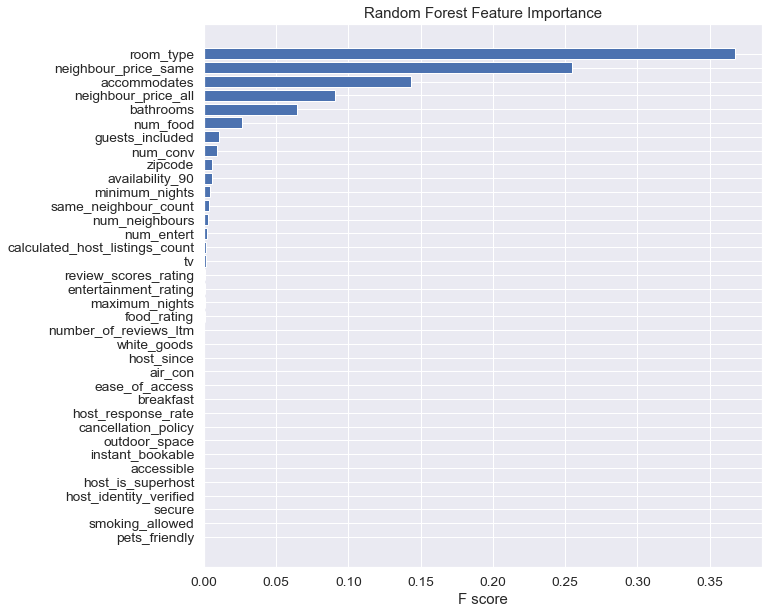

In [205]:
# RF Feature Importance
rf_feat_imp = pd.DataFrame(rf_best_model.feature_importances_, index = X_train.columns, columns = ['weight']).sort_values('weight')
fig, ax = plt.subplots(1, figsize=(10,10))
ax.grid(zorder=0)
ax.barh(rf_feat_imp.index,rf_feat_imp.weight) 
plt.xlabel("F score", fontsize=15)
ax.set_title('Random Forest Feature Importance', fontdict={'fontsize':'15','fontweight':5})

## Permutation Importance<a class="anchor" id="pi"></a>
However, as Strobl et al. (2007) show, Random Forests **feature importances** based on **impurity** are **biased** towards **high cardinality** features (i.e. with many possible splits). This means that even if a numerical variable has no predictive power it will have an **artificially inflated** importance by this measure due to the many possible splits. Furthermore, as the importances are calculated from the **training set**, it may not necessarily reflect that a feature has predictive power on the test set, because we have not restricted the model from using a random numerical feature to overfit on the training set.

To tackle these 2 issues, we can use **Permutation Importance**. Its idea is that the values of each of the independent variables are shuffled randomly and then we measure how much the accuracy of the model decreases. The intuitions is that if a variable is not important, then shuffling it will not make it more so, so model accuracy should not be affected (Molnar, 2019).

To check whether a variable is truly important rather than important because it can overfit, we can calculate Permutation Importance on the **test set** — this helps make sure the model isn’t just overfitting on the training set. The results come out very similar to the simple Feature Importance scores suggesting we may not have the problem of variables with no predictive power being deemed artificially important. An interesting observation is that the number of convenience stores (num_conv) seems to be as important as guests included in the Feature Importance, but has a very meaningless permutation importance in the test set - this could suggest that it has no explanatory power, but simply benefits from its high cardinality.

In [78]:
from sklearn.inspection import permutation_importance

# Permutation Importance on Training Set
rf_perm_imp = permutation_importance(rf_best_model, X_train, y_train,
                                    n_repeats=10, random_state = 42)

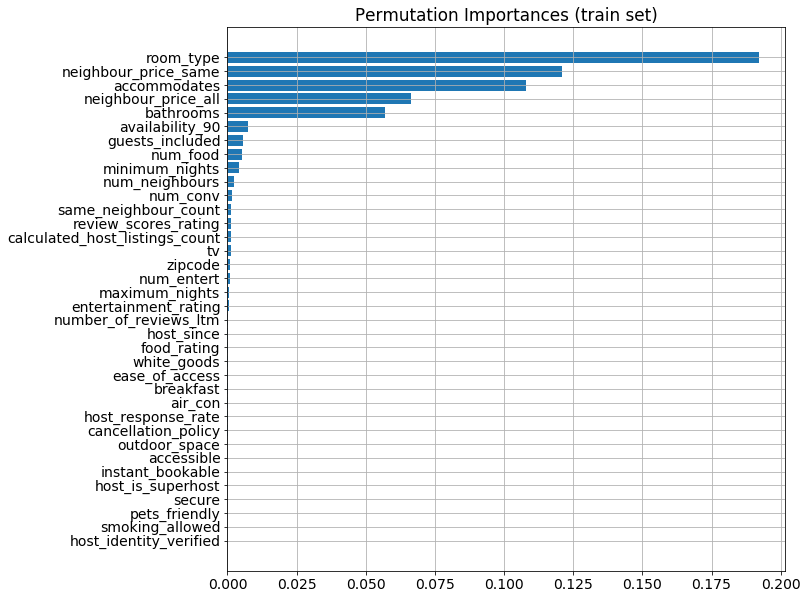

In [79]:
# Plot Importance
sorted_idx = rf_perm_imp.importances_mean.argsort()
fig,ax = plt.subplots(figsize=(10,10))
ax.grid(zorder=0)
ax.barh( X_test.columns[sorted_idx], rf_perm_imp.importances_mean[sorted_idx] )
ax.set_title('Permutation Importances (train set)')
plt.rc('font',size = 14)
plt.xlim(xmin=0)
plt.show()

In [64]:
# Permutation Importance on Test Set
rf_perm_imp = permutation_importance(rf_best_model, X_test, y_test,
                                    n_repeats=10, random_state = 42)

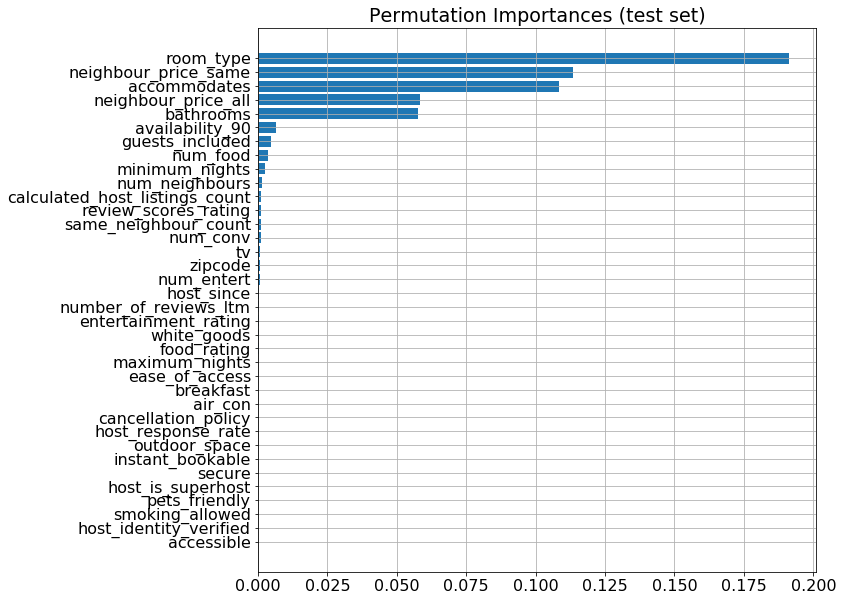

In [77]:
# Plot Importance
sorted_idx = rf_perm_imp.importances_mean.argsort()
fig,ax = plt.subplots(figsize=(10,10))
ax.grid(zorder=0)
ax.barh( X_test.columns[sorted_idx], rf_perm_imp.importances_mean[sorted_idx])
ax.set_title('Permutation Importances (test set)')
plt.xlim(xmin=0)
plt.rc('font',size = 14)
plt.show()

It is important to note that **feature and permutation importance** scores could be misleading, since they may suffer from **“correlation bias”** (Toloşi & Lengauer, 2011) in that if there are 2 correlated features, it may be the case that the less discriminative one could have higher importance and the importance scores for groups of correlated features are **inversely proportional** to the number of features in the correlated group.

The scatterplot below shows that predictions are concentrated much more towards the diagonal line compared to a decision tree. However, unlike XGBoost, the Random Forest algorithm performs worse in correctly predicting high-priced properties - these are significantly under-predicted.

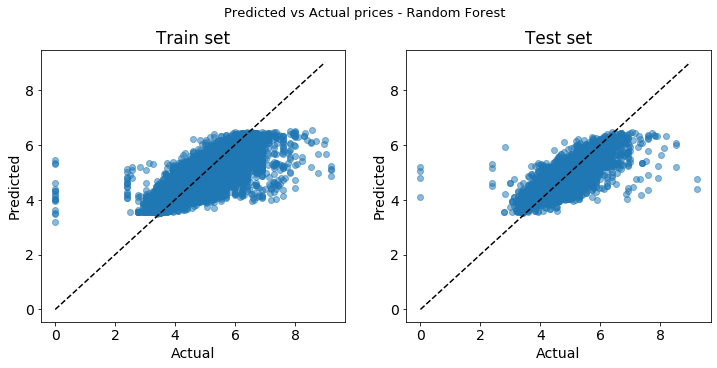

In [82]:
plot_pred_actual(rf_best_model.predict(X_train) , rf_best_model.predict(X_test), 'Random Forest')

## Conclusion<a class="anchor" id="conclusion"></a>

To conclude, in this analysis I used 3 different techniques to try and predict Airbnb listing prices and see which features are important. The models came rather close to each other, with XGBoost being marginally better, able to predict prices within a factor of 1.45 of actual prices and able to explain 70% of the variation in prices. The models agreed to a large extent on the important features with **room_type , bathrooms, neighbour_price, accommodates** being very important while attributes like **zipcode, neighbour count, number of reviews , cancellation policy** having no explanatory power.

I would like to point out some limitations such as not including some features like cleaning fee and security deposit, based on my personal judgment of their lack of importance. Furthermore, with only asking prices, rather than transaction prices being publicly available, there is a risk of these prices being overestimated and thus misleading. Perhaps, rather than using zip code as numerical variable, we could get more insights by using a few main neighbourhoods.

Next steps would be to perhaps eliminate some irrelevant features and recompute the models to moderate the problem of correlated features showing misleading importance scores/orders (Gregorutti, Michel & Saint-Pierre, 2013). As I didn’t eliminate correlated features, there is a danger that some features were artificially deflated.

## References<a class="anchor" id="ref"></a>

Airbnb (2020) Available from: https://www.airbnb.co.uk/trust [Accessed 28/08/2020].

Benoit, K. (2011) Linear Regression Models with Logarithmic Transformations . Available from: https://kenbenoit.net/assets/courses/ME104/logmodels2.pdf [Accessed 28/08/2020].

Berrar, D. (2018) Cross-Validation. Encyclopedia of Bioinformatics and Computational Biology , Elsevier. pp. 542-545.
Breiman, L. (2001) Random Forests . Machine Learning. 45 (1), 28/08/2020.

Brownlee, J. (2019) Understand the Impact of Learning Rate on Neural Network Performance. Available from: https://machinelearningmastery.com/understand-the- dynamics-of-learning-rate-on-deep-learning-neural-networks/ [Accessed 28/08/2020].

Brownlee, J. (2016) Feature Importance and Feature Selection With XGBoost in Python. Available from: https://machinelearningmastery.com/feature-importance-and-feature- selection-with-xgboost-in-python/ [Accessed 28/08/2020].

Brownlee, J. (2016) Tune Learning Rate for Gradient Boosting with XGBoost in Python. Available from: https://machinelearningmastery.com/tune-learning-rate-for-gradient- boosting-with-xgboost-in-python/ [Accessed 28/08/2020].

Business Insider (2017) Available from: https://www.pulse.ng/bi/tech/tech-airbnb- now-has-more-listings-worldwide-than-the-top-five-hotel-brands-combined/g744ngp [Accessed 28/08/2020].

Chang, R. (2017) Using Machine Learning to Predict Value of Homes On Airbnb. Available from: https://medium.com/airbnb-engineering/using-machine-learning-to-predict- value-of-homes-on-airbnb-9272d3d4739d [Accessed 28/08/2020].

Coles, P., Egesdal, M., Ellen, I., Li, X. & Sundararajan, A. (2017) Airbnb Usage Across New York City Neighborhoods: Geographic Patterns and Regulatory Implications.
In: Forthcoming, Cambridge Handbook on the Law of the Sharing Economy.

Dingwall, N. & Chris, P. (2016) Are categorical variables getting lost in your random forests?. Available from: https://roamanalytics.com/2016/10/28/are-categorical- variables-getting-lost-in-your-random-forests/ [Accessed 28/08/2020].

Geron, A. (2017) Ensemble Learning and Random Forests . In: Hands-On Machine Learning with Scikit-Learn and TensorTlow: Concepts, Tools, and Techniques to Build Intelligent Systems. 1st edition. Sebastopol, O'Reilly Media, Incorporated. pp. 183-187.

Gregorutti, B., Michel, B. & Saint-Pierre, P. (2013) Correlation and variable importance in random forests. Statistics and Computing. 27 (3), Available from: https:// www.researchgate.net/publication/ 258083104_Correlation_and_variable_importance_in_random_forests [Accessed 27/08/2020].

James, G., Witten, D., Hastie, T. & Tibshirani, R. (2013) Bagging, Random Forests, Boosting. In: Anonymous An introduction to statistical learning : with applications in R New York, Springer. pp. 318-319.

McDonald, J. H. (2014) Spearman Correlation. Handbook of Biological Statistics . 3rd edition. Baltimore, Maryland, Sparky House Publishing. pp. 209-212.

Molnar, C. (2019) Permutation Feature Importance. Interpretable machine learning https://christophm.github.io/interpretable-ml-book/cite.html

Much Needed (2020) Available from: https://muchneeded.com/airbnb-statistics/ [Accessed 28/08/2020].

Starmer, J. (2019) XGBoost Part 1: Regression. [Video] Available from: https:// www.youtube.com/watch?v=OtD8wVaFm6E .

Strobl, C., Boulesteix, A., Zeileis, A. & Torsten, H. (2007) Bias in random forest variable importance measures: Illustrations, sources and a solution. . BMC Bioinformatics. 8 28/08/2020.

Toloşi, L. & Lengauer, T. (2011) Classification with correlated features: unreliability of feature ranking and solutions. Bioinformatics. 27 (14), 28/08/2020.

XGBoost Documentation. (2020) Available from: https://xgboost.readthedocs.io/en/ latest/python/python_api.html [Accessed 28/08/2020].